# "Urban Visual Analysis: Clustering and Feature Extraction of City Images"

## Overview

**The primary aim of this project is to define patterns, similarities, and distinctions between cities based on their visual characteristics.**

In [1]:
from IPython.display import display
import pandas as pd

pd.set_option('display.max_rows', None)       # Show all rows
pd.set_option('display.max_columns', None)    # Show all columns
pd.set_option('display.max_colwidth', None)   # Display full width of each cell
pd.set_option('display.width', None)          # Increase display width
pd.set_option('display.colheader_justify', 'left')   

In [2]:
import os
import random
root_path = (r"C:/Users/maria/Desktop/gsv")
dataframes_path = os.path.join(root_path, 'Dataframes')
images_path = os.path.join(root_path, 'Images')

Displaying images from city: Bangkok


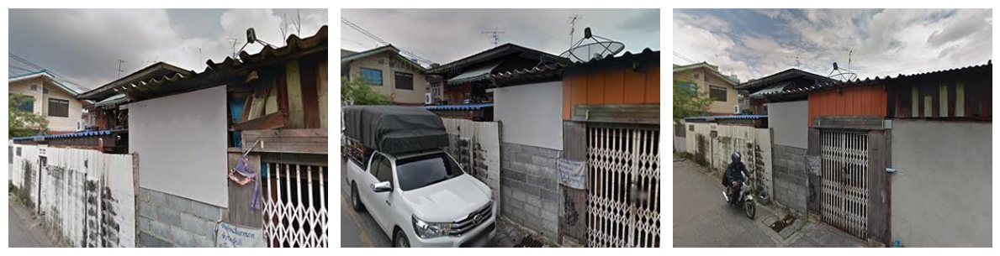

Displaying images from city: Barcelona


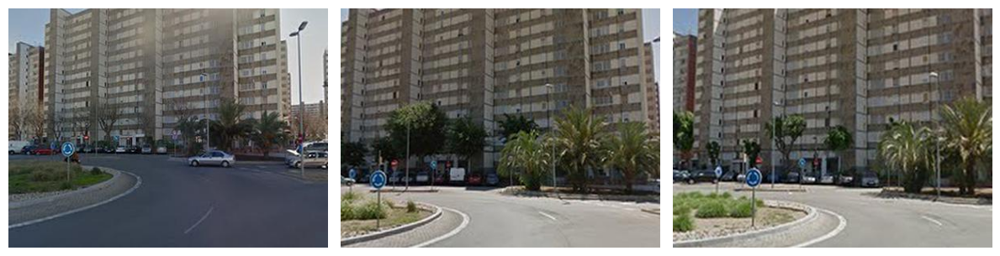

Displaying images from city: Boston


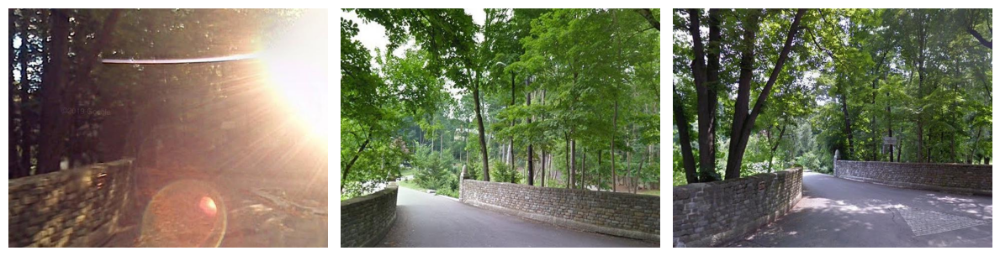

Displaying images from city: Brussels


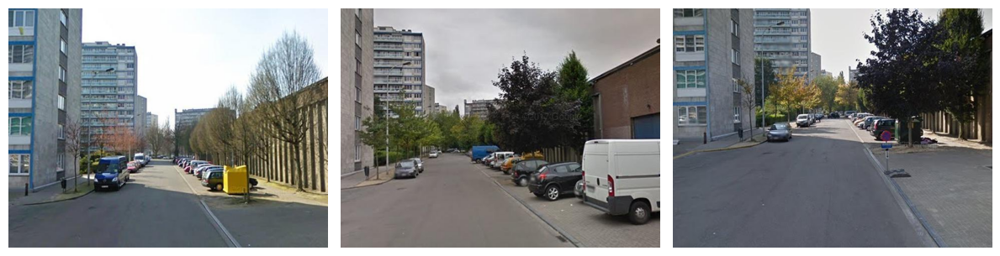

Displaying images from city: BuenosAires


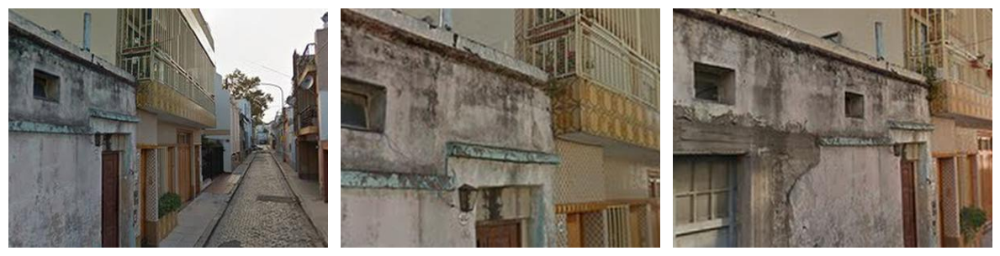

Displaying images from city: Chicago


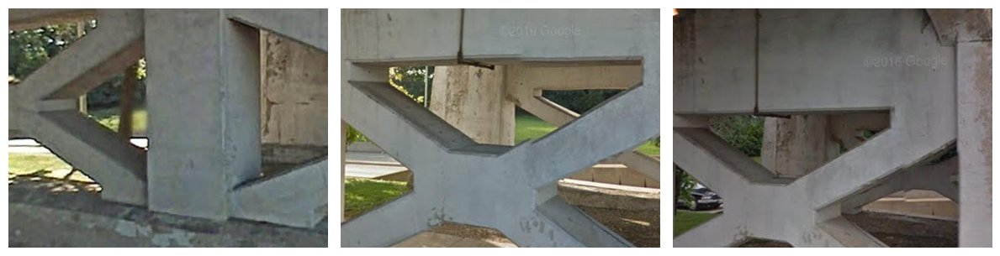

Displaying images from city: Lisbon


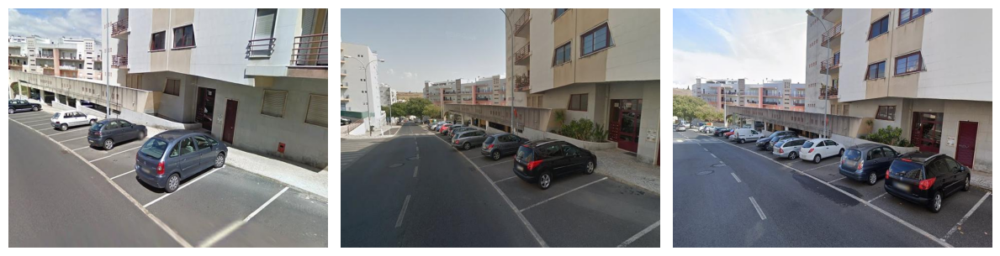

Displaying images from city: London


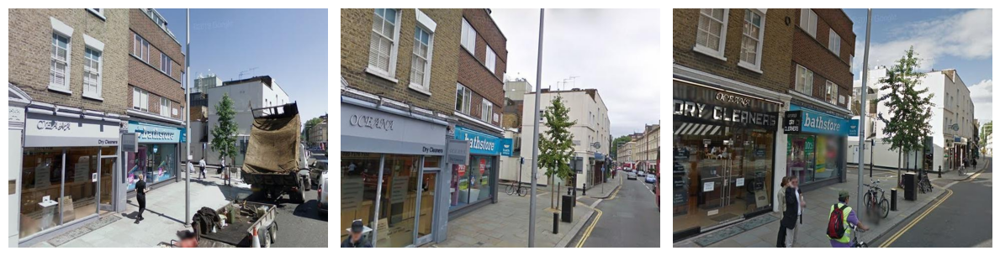

Displaying images from city: LosAngeles


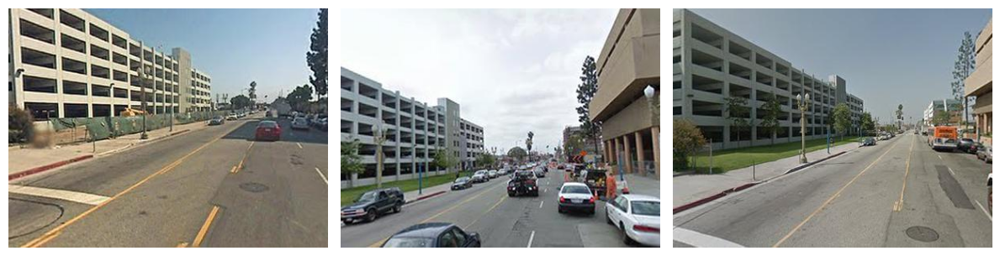

Displaying images from city: Madrid


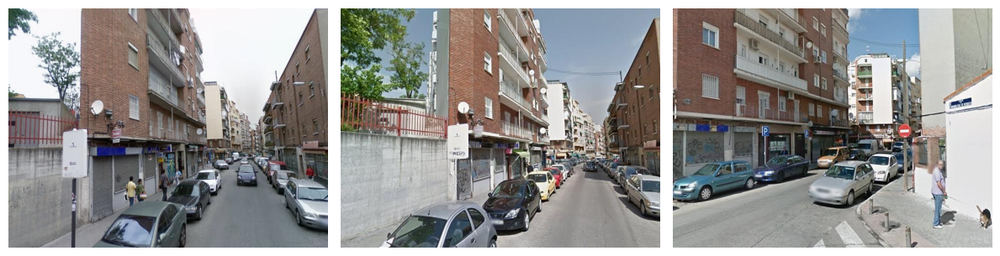

Displaying images from city: Medellin


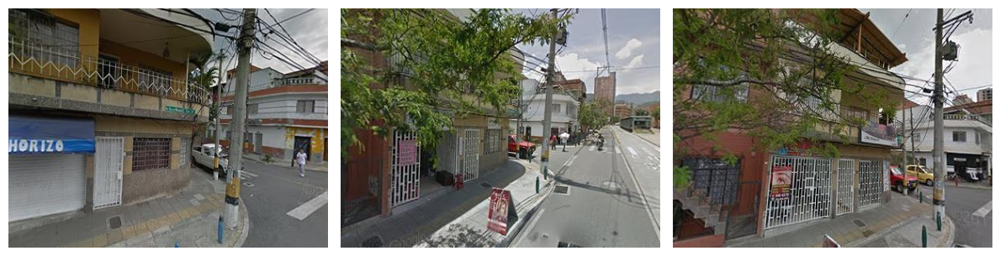

Displaying images from city: Melbourne


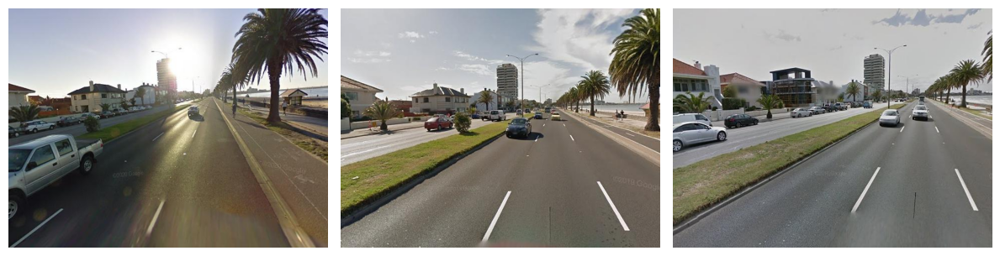

Displaying images from city: MexicoCity


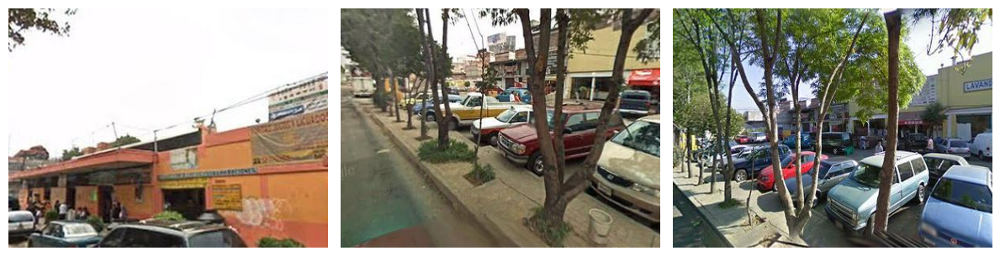

Displaying images from city: Miami


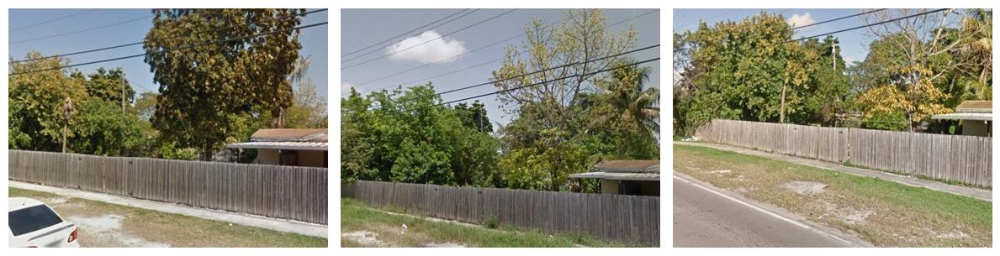

Displaying images from city: Minneapolis


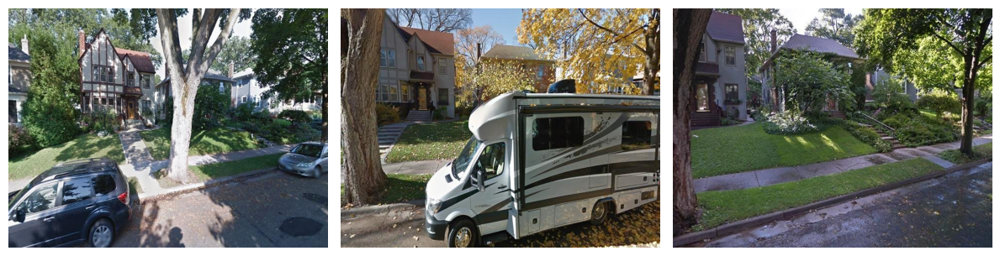

Displaying images from city: Osaka


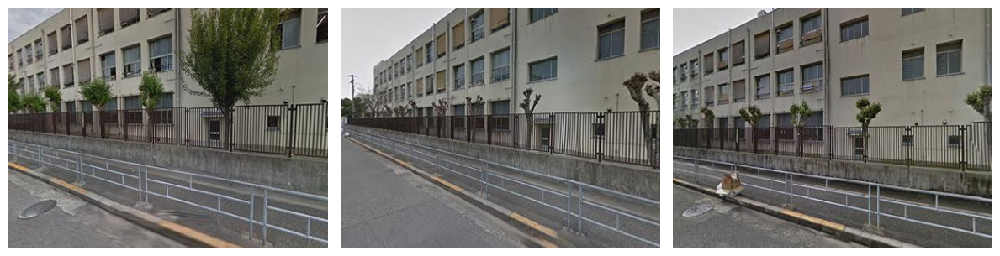

Displaying images from city: OSL


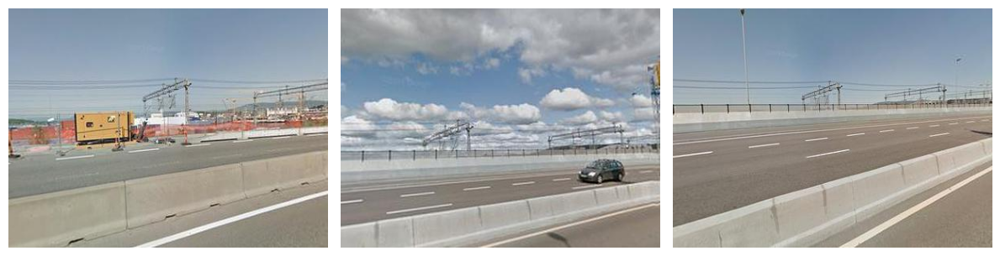

Displaying images from city: Phoenix


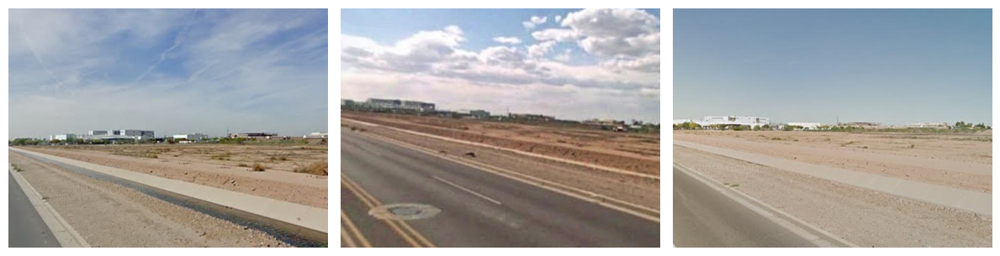

Displaying images from city: PRS


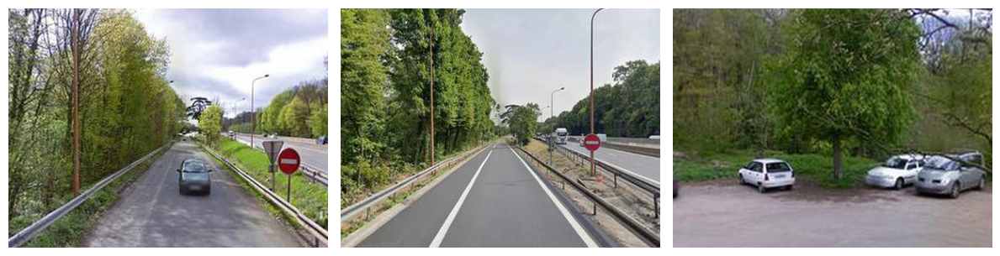

Displaying images from city: Rome


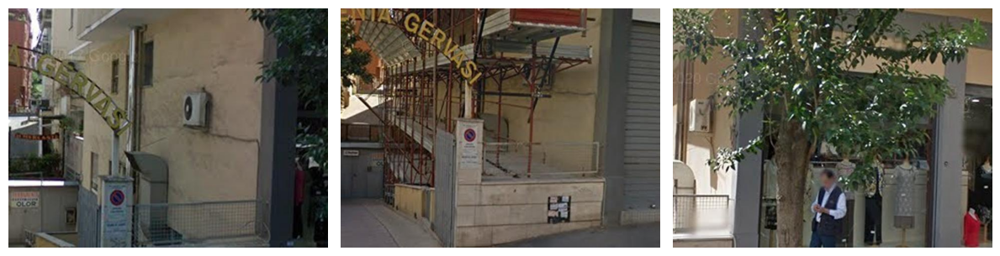

Displaying images from city: TRT


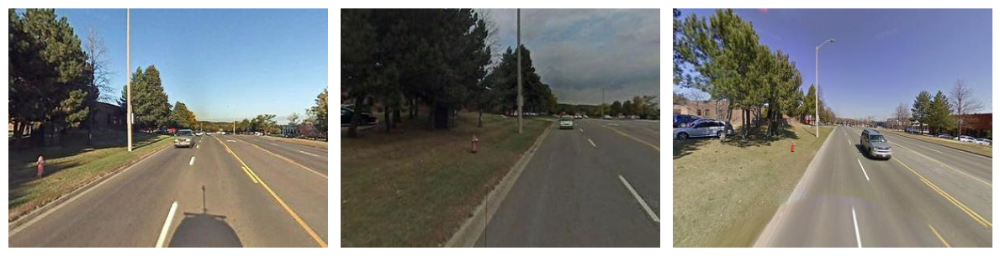

Displaying images from city: WashingtonDC


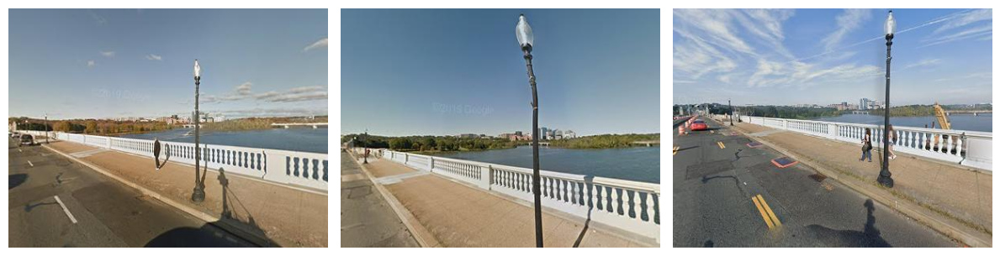

In [3]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# List the city folders
city_folders = [os.path.join(images_path, city) for city in os.listdir(images_path) if os.path.isdir(os.path.join(images_path, city))]

# Set the number of images to display per city
images_per_city = 3
valid_extensions = ['.jpg', '.png']

for city_folder in city_folders:
    print(f"Displaying images from city: {os.path.basename(city_folder)}")
    
    # Get all image files in the city folder
    image_files = [
        os.path.join(city_folder, img) 
        for img in os.listdir(city_folder) 
        if any(img.lower().endswith(ext) for ext in valid_extensions)
    ]
    
    if image_files:
        # Select up to 3 images from the city folder
        selected_images = image_files[:images_per_city]
        
        # Plot the selected images
        plt.figure(figsize=(12, 4))
        for i, img_path in enumerate(selected_images):
            try:
                img = Image.open(img_path)
                plt.subplot(1, len(selected_images), i + 1)
                plt.imshow(img)
                #plt.title(f"{os.path.basename(city_folder)}: {os.path.basename(img_path)}")
                plt.axis("off")
            except Exception as e:
                print(f"Error opening image {img_path}: {e}")
        
        plt.tight_layout()
        plt.show()
    else:
        print(f"No valid images found in the folder: {city_folder}")


In [4]:
city_dataframes = {}
for filename in os.listdir(dataframes_path):
    if filename.endswith('.csv'):
        city_name = filename.split('.')[0]
        city_dataframes[city_name] = pd.read_csv(os.path.join(dataframes_path, filename))

In [5]:
sampled_dataframes = {}
for city, df in city_dataframes.items():
    sample_size = 124 # Cap at 500 images per city
    sampled_dataframes[city] = df.sample(n=sample_size, random_state=42)

# Combine all sampled dataframes into one without adding a 'city' column
combined_df = pd.concat(sampled_dataframes.values(), ignore_index=True)

In [6]:
# Function to get image filename
def get_img_name(row):
    '''Given a row from the dataframe, return the corresponding image name'''
    city = row['city_id']
    place_id = str(row['place_id']).zfill(7)  # Zero pad place_id to 7 digits
    panoid = row['panoid']
    year = str(row['year']).zfill(4)
    month = str(row['month']).zfill(2)
    northdeg = str(row['northdeg']).zfill(3)
    lat, lon = str(row['lat']), str(row['lon'])
    name = f"{city}_{place_id}_{year}_{month}_{northdeg}_{lat}_{lon}_{panoid}.jpg"
    return name

In [ ]:
import os
import pickle
import cv2
preprocessed_images = []

for _, row in combined_df.iterrows():
    try:
        # Generate the image path
        image_filename = get_img_name(row)
        city = row['city_id']
        image_path = os.path.join(images_path, str(city), image_filename)

        # Ensure the image exists
        if os.path.exists(image_path):
            print(f"Processing image: {image_filename}")
            # Read the image using OpenCV
            image = cv2.imread(image_path)
            if image is not None:
                preprocessed_images.append({
                    'city': city,
                    'image_name': image_filename,
                    'image_path': image_path,
                    'image': image  # Store the image in memory if needed
                })
            else:
                print(f"Failed to load image: {image_filename}")
        else:
            print(f"Image not found: {image_path}")
    except Exception as e:
        print(f"Error processing row {row['place_id']}: {e}")

# Save the data for later use
with open('preprocessed_images.pkl', 'wb') as f:
    for item in preprocessed_images:
        pickle.dump(item, f)

print("Preprocessing complete. Data saved to 'preprocessed_images.pkl'")

# IMAGE FEATURES

## DOMINANT COLORS -  `extract_dominant_colors` Function

This function identifies the dominant colors in an image using K-means clustering. 

#### Parameters: 

1. **Convert Image to RGB**:
   - Converts the BGR-formatted image to RGB for color consistency.

2. **Reshape Image**:
   - Flattens the image into a 2D array where each pixel's color is represented as a row.

4. **K-means Clustering**:
   - Performs K-means clustering on the pixel data to group pixels into `k` clusters (`k=7`).
   - Configured with:
     - `n_clusters=k`: Number of clusters.
     - `max_iter=1000`: Maximum iterations for convergence.
     - `n_init=10`: Number of initializations for stability.
     - `tol=1e-04`: Convergence tolerance.
     - `random_state=42`: Ensures reproducibility.

5. **Extract and Sort Dominant Colors**:
   - Retrieves the cluster centers as dominant colors.
   - Counts occurrences of each cluster (frequency).
   - Sorts the colors by frequency in descending order.

In [9]:
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from collections import defaultdict 

# Function to extract dominant colors using K-means
def extract_dominant_colors(image, k=7):
    """
    Extracts the dominant colors from an image using K-means clustering.
    """
    try:
        if image is None:
            print("Image is None.")
            return None, None
        
        # Convert to RGB
        img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        pixels = img_rgb.reshape(-1, 3)  # Flatten the image
        
        # Apply K-means clustering
        kmeans = KMeans(n_clusters=k,max_iter=1000, n_init=10, tol=1e-04 ,random_state=42)
        kmeans.fit(pixels)
        
        # Extract dominant colors and their frequencies
        dominant_colors = kmeans.cluster_centers_
        dominant_colors = np.round(dominant_colors).astype(int)
        
        labels = kmeans.labels_
        label_counts = np.bincount(labels)
        sorted_indices = np.argsort(label_counts)[::-1]  # Sort by frequency, descending
        
        sorted_colors = dominant_colors[sorted_indices]
        sorted_frequencies = label_counts[sorted_indices]
        
        return sorted_colors, sorted_frequencies
    except Exception as e:
        print(f"Error extracting dominant colors: {e}")
        return None, None

# Function to visualize the dominant colors of an image
def visualize_colors(dominant_colors, frequencies, title):
    # Normalize frequencies for visualization
    freq_normalized = frequencies / np.max(frequencies)

    # Set up a plot with each color as a bar for the image
    fig, ax = plt.subplots(figsize=(10, 2))  # Size of the plot

    # Create a solid color bar for each dominant color, with vivid colors
    for i, (color, freq) in enumerate(zip(dominant_colors, freq_normalized)):
        # Convert RGB values to float range [0, 1] for Matplotlib
        color_rgb = np.array(color) / 255.0
        
        # Directly set the bar color to ensure vividness
        ax.barh(i, 1, color=color_rgb, edgecolor='black')
        ax.text(1.05, i, f'{frequencies[i]:.0f}', va='center', ha='left', fontsize=12, color='black')

    # Add color hex codes next to the bars
    for i, color in enumerate(dominant_colors):
        hex_color = f'#{int(color[0]):02X}{int(color[1]):02X}{int(color[2]):02X}'
        ax.text(-0.05, i, hex_color, va='center', ha='right', fontsize=12, color='black')

    # Remove axis details for a cleaner display
    ax.set_xlim(0, 1.2)
    ax.set_yticks(range(len(dominant_colors)))
    ax.set_yticklabels([f'Color {i+1}' for i in range(len(dominant_colors))])
    ax.set_title(f"{title}", fontsize=14)

    # Display the plot with tight layout
    plt.tight_layout()
    plt.show()

# Process preprocessed images
image_data = []
city_image_data = defaultdict(list)

# Process images and group by city
for item in preprocessed_images:
    try:
        city = item['city']
        image_name = item['image_name']
        image = item['image']  # Loaded image in memory
        
        #print(f"Processing image: {image_name}")
        
        # Extract dominant colors
        dominant_colors, frequencies = extract_dominant_colors(image, k=7)
        
        if dominant_colors is None or frequencies is None:
            print(f"Skipping image: {image_name}")
            continue
        
        # Store processed data
        city_image_data[city].append({
            'image_name': image_name,
            'dominant_colors': dominant_colors.tolist(),
            'frequencies': frequencies.tolist(),
        })

    except Exception as e:
        print(f"Error processing image {item['image_name']}: {e}")

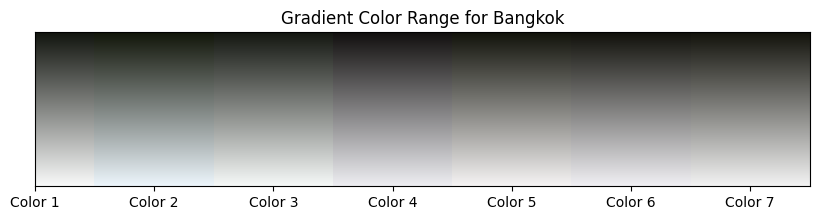

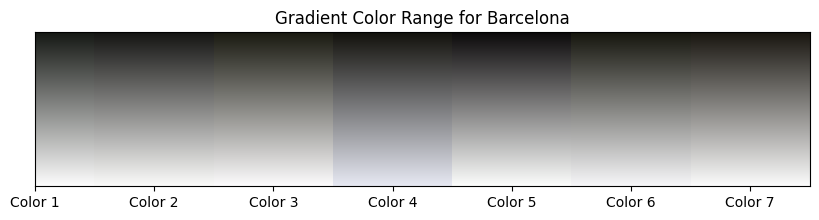

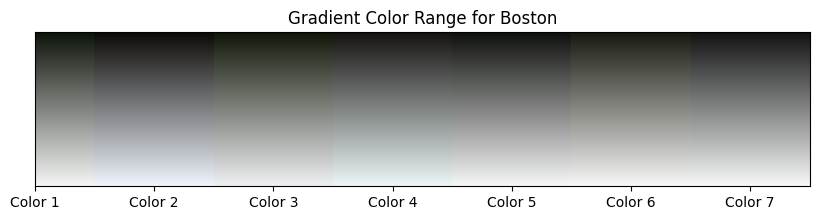

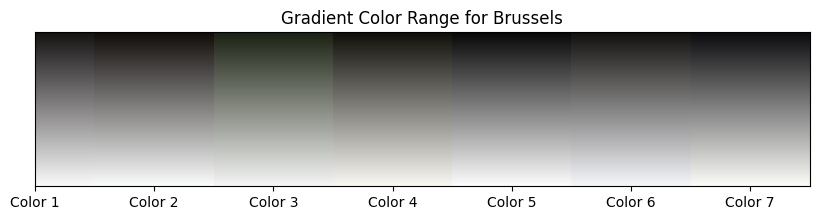

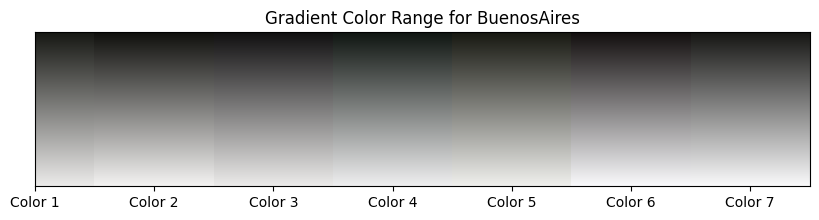

...

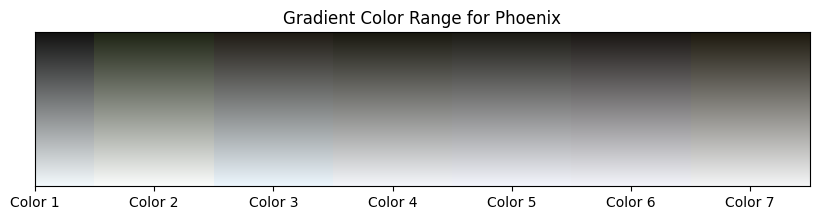

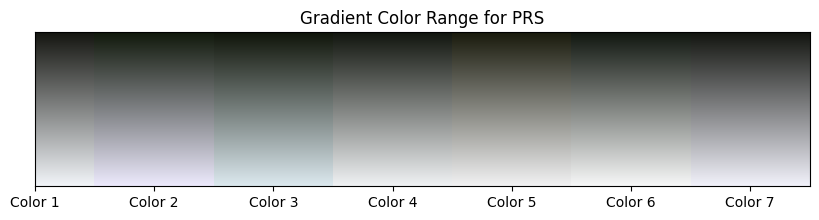

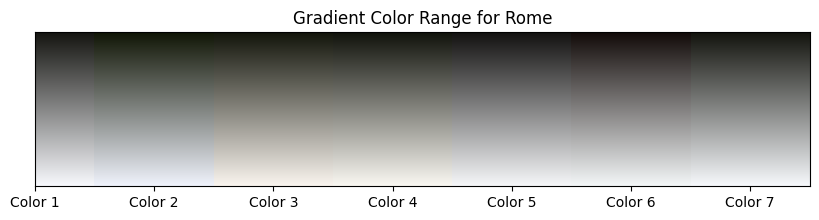

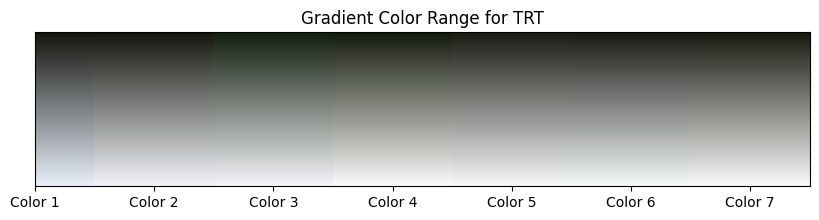

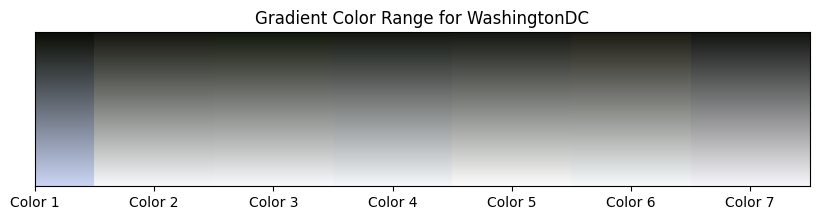

In [10]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_color_range(city_image_data):
    for city, data in city_image_data.items():
        if data:
            # Calculate the min and max dominant colors across all images in the city
            all_dominant_colors = np.array([entry['dominant_colors'] for entry in data])
            min_colors = np.min(all_dominant_colors, axis=0)
            max_colors = np.max(all_dominant_colors, axis=0)
            
            # Enhanced visualization
            fig, ax = plt.subplots(figsize=(10, 2))
            for i in range(min_colors.shape[0]):
                gradient = np.linspace(min_colors[i] / 255.0, max_colors[i] / 255.0, 256).reshape(256, 1, 3)
                ax.imshow(gradient, aspect='auto', extent=[i, i+1, 0, 1])
            
            ax.set_xticks(np.arange(len(min_colors)) + 0.5)
            ax.set_xticklabels([f"Color {i+1}" for i in range(len(min_colors))])
            ax.set_yticks([])
            ax.set_title(f"Gradient Color Range for {city}")
            
           
            plt.show()

visualize_color_range(city_image_data)

## HISTOGRAMS

### `color_histogram` Function

This function computes the color histogram of an image, providing insights into the distribution of pixel intensities for each color channel (Red, Green, and Blue).

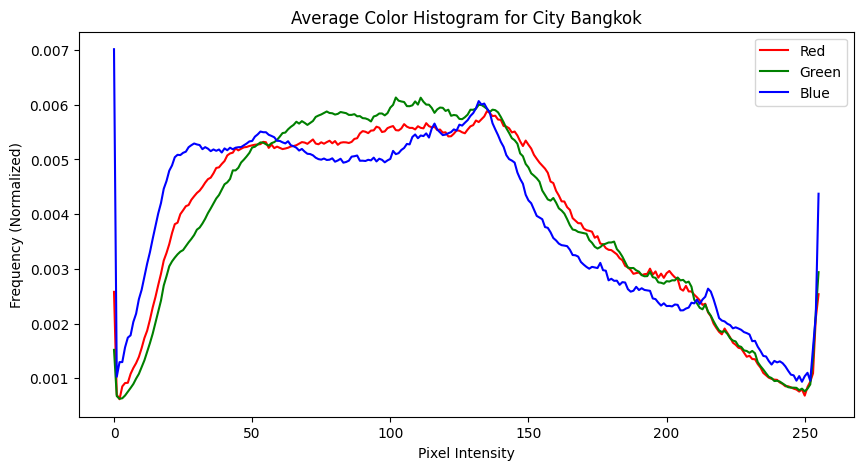

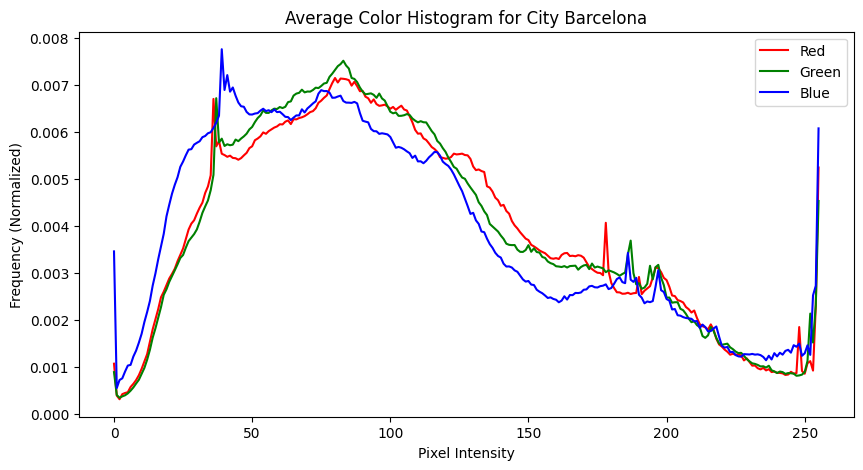

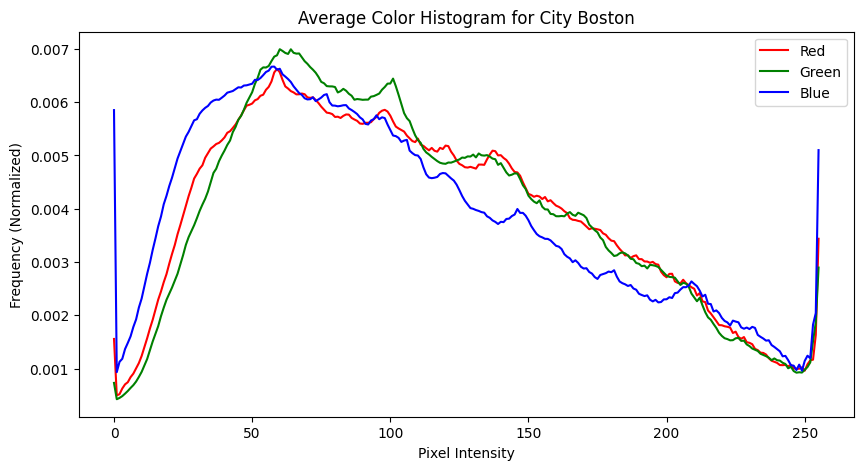

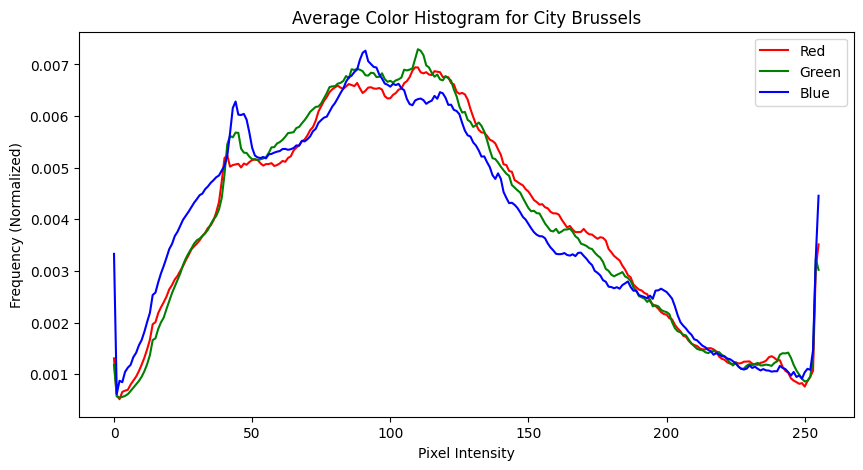

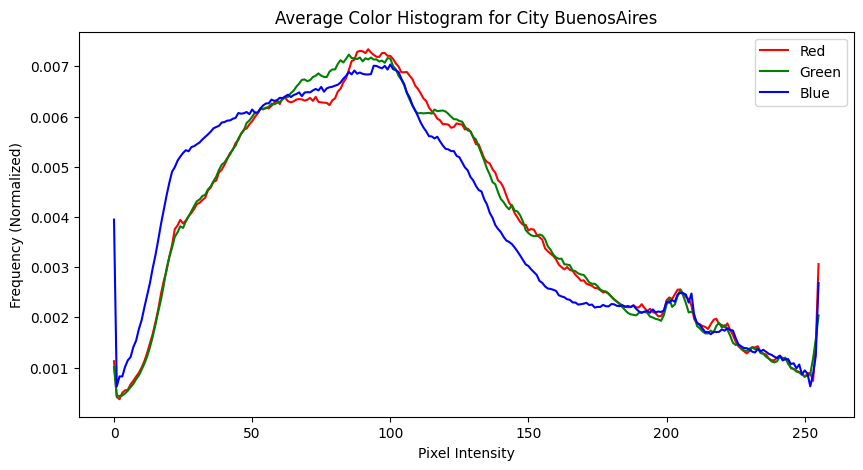

...

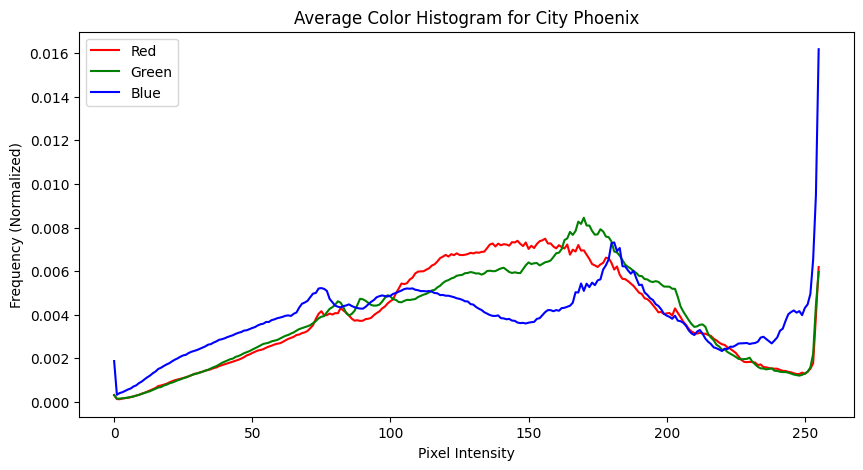

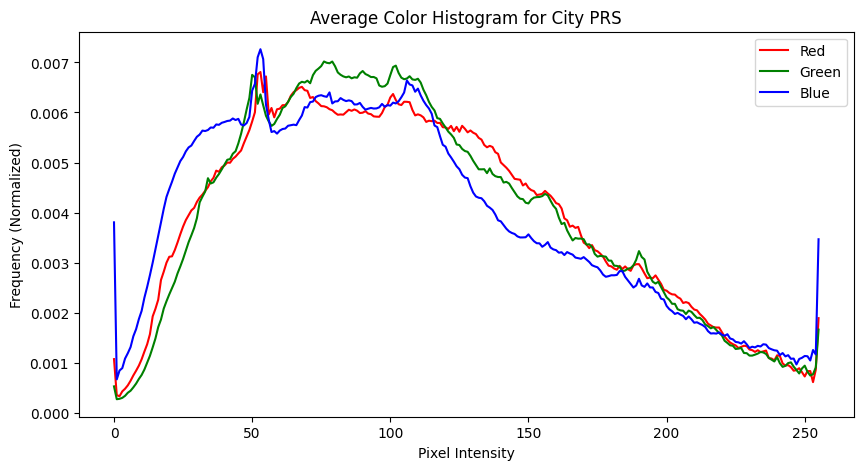

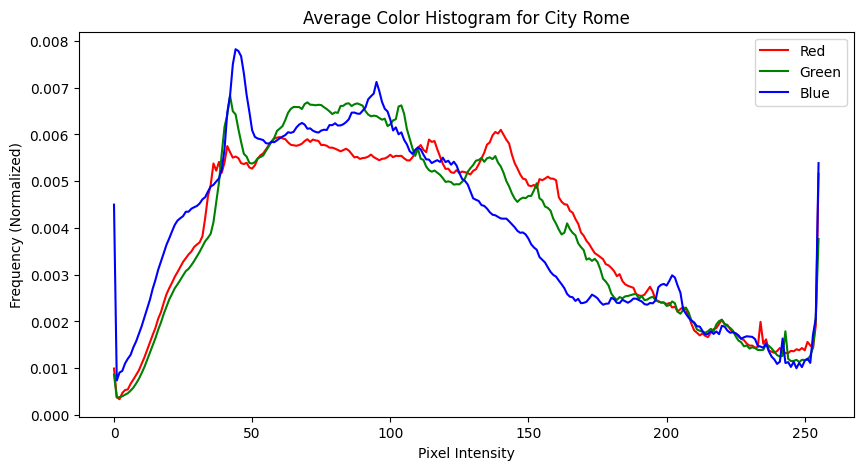

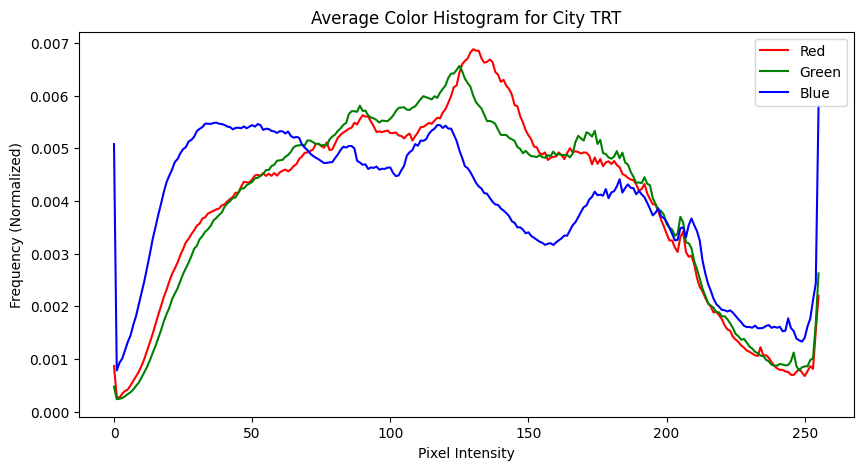

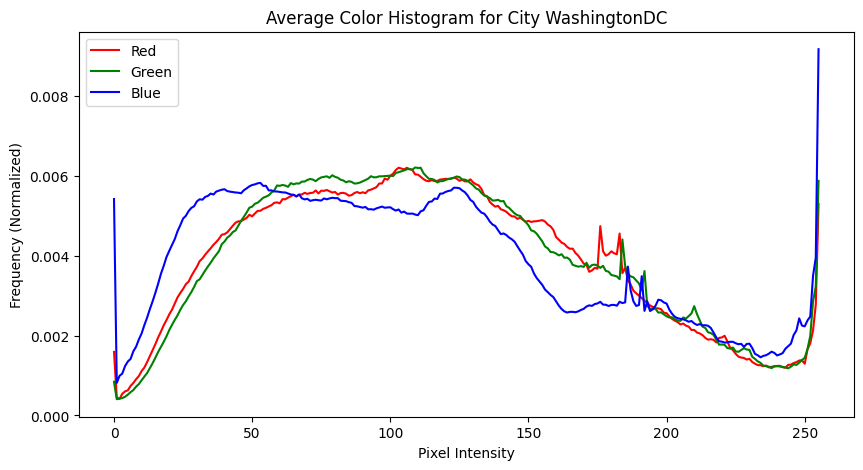

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import os
import cv2

ROOT_PATH = 'C:/Users/maria/Desktop/gsv'
images_path = os.path.join(ROOT_PATH, 'Images')

# Function to calculate color histograms
def color_histogram(image):
    # Compute histograms for each channel
    hist_r = np.histogram(image[:, :, 2], bins=256, range=(0, 255))[0]
    hist_g = np.histogram(image[:, :, 1], bins=256, range=(0, 255))[0]
    hist_b = np.histogram(image[:, :, 0], bins=256, range=(0, 255))[0]
    
    # Normalize histograms
    hist_r = hist_r / hist_r.sum()
    hist_g = hist_g / hist_g.sum()
    hist_b = hist_b / hist_b.sum()
    
    # Concatenate histograms (R, G, B)
    return np.concatenate([hist_r, hist_g, hist_b])

# Dictionary to store histograms by city
city_histograms = {}

# Iterate over preprocessed images
for item in preprocessed_images:
    try:
        city = item['city']  # Precomputed city info
        image = item['image']  # Precomputed image

        #print(f"Processing histogram for image: {item['image_name']}")  

        if image is not None:
            # Compute histogram for the image
            hist = color_histogram(image)

            # Add histogram to city's list
            if city not in city_histograms:
                city_histograms[city] = []
            city_histograms[city].append(hist)
        else:
            print(f"Failed to process image: {item['image_name']}")
    except Exception as e:
        print(f"Error processing image {item['image_name']}: {e}")

# Compute average histograms for each city
average_histograms = {city: np.mean(hist_list, axis=0) for city, hist_list in city_histograms.items()}

# Visualize average histograms
for city, avg_hist in average_histograms.items():
    # Split concatenated histograms back into R, G, B
    hist_r, hist_g, hist_b = np.split(avg_hist, 3)
    
    plt.figure(figsize=(10, 5))
    plt.plot(hist_r, color='red', label='Red')
    plt.plot(hist_g, color='green', label='Green')
    plt.plot(hist_b, color='blue', label='Blue')
    plt.title(f'Average Color Histogram for City {city}')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency (Normalized)')
    plt.legend()
    plt.show()


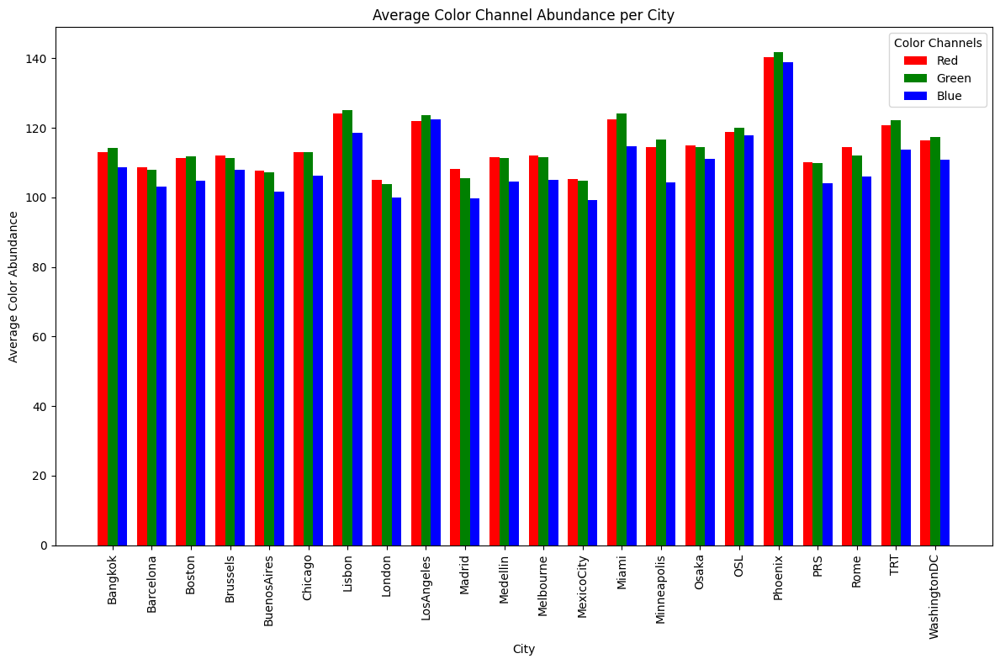

In [12]:
import matplotlib.pyplot as plt
import numpy as np

# Create arrays to store the average RGB values for each city
cities = list(average_histograms.keys())
average_red = []
average_green = []
average_blue = []

# Calculate average RGB abundance for each city
for city, avg_hist in average_histograms.items():
    hist_r, hist_g, hist_b = np.split(avg_hist, 3)
    
    # Calculate the average value of each channel (weighted by the histogram)
    avg_red = np.sum(hist_r * np.arange(256))  # Weighted average of red channel
    avg_green = np.sum(hist_g * np.arange(256))  # Weighted average of green channel
    avg_blue = np.sum(hist_b * np.arange(256))  # Weighted average of blue channel
    
    average_red.append(avg_red)
    average_green.append(avg_green)
    average_blue.append(avg_blue)

# Plotting the bar plot for each city's average RGB abundance
bar_width = 0.25
x_pos = np.arange(len(cities))  # Position of each city on the x-axis

# Create the figure
plt.figure(figsize=(12, 8))

# Plot bars for Red, Green, and Blue abundances
plt.bar(x_pos - bar_width, average_red, bar_width, color='red', label='Red')
plt.bar(x_pos, average_green, bar_width, color='green', label='Green')
plt.bar(x_pos + bar_width, average_blue, bar_width, color='blue', label='Blue')

# Add labels and title
plt.xlabel('City')
plt.ylabel('Average Color Abundance')
plt.title('Average Color Channel Abundance per City')

# Set x-axis ticks and labels
plt.xticks(x_pos, cities, rotation=90)

# Add a legend
plt.legend(title='Color Channels')

# Adjust layout to ensure labels fit
plt.tight_layout()

# Show the plot
plt.show()


## **Feature Functions**

1. `get_image_brightness`:
**Purpose:** Calculates the average brightness of an image by converting it to grayscale and computing the mean pixel intensity. Brightness is a key feature in image analysis, helping to identify overall light or dark characteristics.

2. `texture_features`
**Purpose:** Extracts texture features using Local Binary Patterns (LBP). This function captures surface characteristics such as smoothness, roughness, or regular patterns, useful for texture classification and image analysis.

3. `shape_features`
**Purpose:** Computes shape-related features by analyzing image contours. It quantifies the geometrical structure within an image, often used for object detection or recognition tasks.

4. `analyze_image_properties`
**Purpose:** Evaluates several key image properties, including:
- **Sharpness:** Indicates how focused the image is.
- **Edge Density:** Quantifies the amount of structural detail in the image.
- **Saturation:** Measures the intensity of colors.

In [15]:
import os
import pickle
import cv2
import numpy as np
import pandas as pd
from PIL import Image, ImageStat
import matplotlib.pyplot as plt
import seaborn as sns
from skimage.feature import local_binary_pattern

# Feature extraction functions
def get_image_brightness(image_path):
    with Image.open(image_path) as img:
        grayscale_img = img.convert("L")  # Convert to grayscale
        stat = ImageStat.Stat(grayscale_img)
        return stat.mean[0]  # Average brightness

def texture_features(img):
    gray_img = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2GRAY)
    radius = 4
    n_points = 10 * radius
    lbp = local_binary_pattern(gray_img, n_points, radius, method='uniform')
    lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
    lbp_hist = lbp_hist / np.sum(lbp_hist)  # Normalize histogram
    return lbp_hist

def shape_features(img):
    gray_img = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2GRAY)
    _, thresh = cv2.threshold(gray_img, 128, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contour_features = [len(c) for c in contours]
    max_contours = 600
    contour_features = contour_features[:max_contours] + [0] * (max_contours - len(contour_features))
    return np.array(contour_features)

def analyze_image_properties(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    sharpness = laplacian.var()
    edges = cv2.Canny(gray, threshold1=1, threshold2=1)
    edge_density = np.sum(edges > 0) / edges.size
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    saturation = np.mean(hsv[:, :, 1])
    return {"sharpness": sharpness, "edge_density": edge_density, "saturation": saturation}

# Load preprocessed images
with open('preprocessed_images.pkl', 'rb') as f:
    preprocessed_images = []
    while True:
        try:
            preprocessed_images.append(pickle.load(f))
        except EOFError:
            break

# Extract features for each image
image_features = []
for item in preprocessed_images:
    city = item['city']
    image_path = item['image_path']
    try:
        brightness = get_image_brightness(image_path)
        properties = analyze_image_properties(image_path)
        with Image.open(image_path) as img:
            texture = texture_features(img)
            shape = shape_features(img)
        image_features.append({
            "city": city,
            "brightness": brightness,
            "sharpness": properties['sharpness'],
            "edge_density": properties['edge_density'],
            "saturation": properties['saturation'],
            "texture": texture.mean(),  # Aggregate texture features
            "shape": shape.mean()       # Aggregate shape features
        })
    except Exception as e:
        print(f"Error processing {image_path}: {e}")

# Convert to DataFrame
features_df = pd.DataFrame(image_features)


# Group by city and analyze
city_means = features_df.groupby('city').mean()

### Analysis of the features accorording to plots

1. **Brightness Distribution:** The brightness values are fairly normally distributed around the mean. This suggests a consistent level of brightness across the images with moderate variability.

2. **Sharpness Distribution:** Sharpness values are right-skewed, indicating that while many images have moderate sharpness, there are a few with very high sharpness. The large standard deviation suggests significant variation in sharpness.

3. **Edge Density Distribution:** Edge density values are normally distributed and tightly clustered around the mean. This indicates consistent edge density across the dataset, with low variability.

4. **Saturation Distribution:** Saturation values also show a normal distribution with moderate variability, suggesting varied levels of color intensity in the images.

5. **Texture Distribution:** Texture values are very tightly clustered around the mean with minimal variation, indicating uniform texture characteristics across the images.

6. **Shape Distribution:** Shape values appear to be normally distributed, indicating a consistent shape characteristic across the dataset, though with some variability.

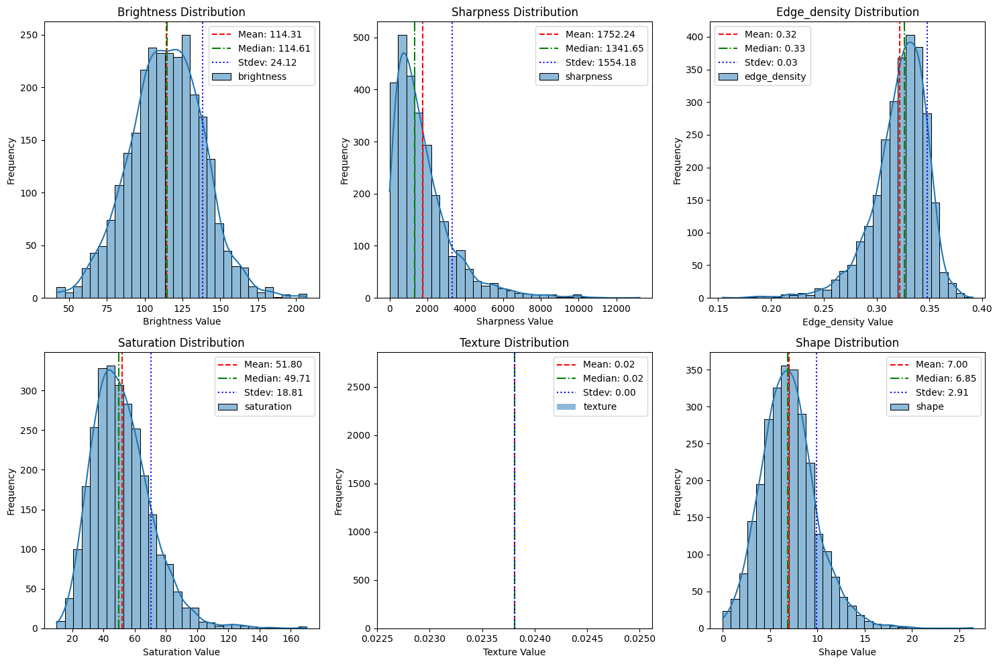

In [16]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Normalize the features using Min-Max Scaling
scaler = MinMaxScaler()
normalized_features = features_df[['brightness', 'sharpness', 'edge_density', 'saturation', 'texture', 'shape']]
normalized_features_scaled = scaler.fit_transform(normalized_features)
normalized_features_df = pd.DataFrame(normalized_features_scaled, columns=normalized_features.columns)


# Investigate sharpness and saturation outliers (extreme values)
sharpness_outliers = features_df[features_df['sharpness'] > features_df['sharpness'].quantile(0.99)]
saturation_outliers = features_df[features_df['saturation'] > features_df['saturation'].quantile(0.99)]

# 3. Highlight Correlations (Histograms with Mean, Median, and Std annotations)
plt.figure(figsize=(15, 10))
for idx, column in enumerate(["brightness", "sharpness", "edge_density", "saturation", "texture", "shape"], 1):
    plt.subplot(2, 3, idx)
    sns.histplot(features_df[column], kde=True, label=column, bins=30)
    mean_val = features_df[column].mean()
    median_val = features_df[column].median()
    std_val = features_df[column].std()
    plt.axvline(mean_val, color='red', linestyle='--', label=f'Mean: {mean_val:.2f}')
    plt.axvline(median_val, color='green', linestyle='-.', label=f'Median: {median_val:.2f}')
    plt.axvline(mean_val + std_val, color='blue', linestyle=':', label=f'Stdev: {std_val:.2f}')
    plt.title(f'{column.capitalize()} Distribution')
    plt.xlabel(f'{column.capitalize()} Value')
    plt.ylabel('Frequency')
    plt.legend()
plt.tight_layout()
plt.show()


5. `calculate_entropy`
**Purpose:** Computes the entropy of the pixel intensity distribution in a grayscale image. Entropy is a measure of randomness or texture complexity in the image.

6. `calculate_center_of_mass`
**Purpose:** Calculates the spatial center of mass of an image based on its pixel intensity distribution. This feature helps in analyzing the geometric center of brightness in the image.

7. `fractal_dimension`
**Purpose:** Estimates the fractal dimension of an image, representing its structural complexity. This is useful for analyzing patterns that exhibit self-similarity or irregularity.

8. `glcm_features`
**Purpose:** Extracts texture properties from an image using the Gray-Level Co-occurrence Matrix (GLCM), including:
- **Contrast:** Intensity difference between neighboring pixels.
- **Dissimilarity:** Variation of gray-level pairs.
- **Homogeneity:** Uniformity of pixel distribution.
- **Energy:** Sum of squared GLCM values (texture uniformity).
- **Correlation:** Linear dependency of pixel intensities.

9. `lbp_features`
**Purpose:** Computes Local Binary Pattern (LBP) features to capture fine texture details. The function provides the mean and standard deviation of the LBP histogram, describing the texture's uniformity and variability.

In [17]:
import os
import pickle
import cv2
import numpy as np
import pandas as pd
from PIL import Image, ImageStat
from skimage.feature import  local_binary_pattern
from skimage.feature.texture import graycomatrix, graycoprops
from scipy.stats import entropy

# 1. Brightness
def get_image_brightness(image_path):
    try:
        with Image.open(image_path) as img:
            grayscale_img = img.convert("L")  # Convert to grayscale
            stat = ImageStat.Stat(grayscale_img)
            return stat.mean[0]  # Average brightness
    except Exception as e:
        print(f"Error in brightness extraction: {e}")
        return None

# 2. Entropy
def calculate_entropy(image_path):
    try:
        with Image.open(image_path) as img:
            grayscale_img = img.convert("L")  # Convert to grayscale
            hist, _ = np.histogram(np.array(grayscale_img).flatten(), bins=256, range=(0, 256))
            hist = hist / hist.sum()  # Normalize histogram
            return entropy(hist)
    except Exception as e:
        print(f"Error in entropy calculation: {e}")
        return None

# 3. Spatial Features: Center of Mass
def calculate_center_of_mass(image_path):
    try:
        img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        M = cv2.moments(img)
        if M['m00'] == 0:  # To avoid division by zero
            return 0, 0
        cx = M['m10'] / M['m00']  # X-coordinate of center of mass
        cy = M['m01'] / M['m00']  # Y-coordinate of center of mass
        return cx, cy
    except Exception as e:
        print(f"Error in center of mass calculation: {e}")
        return None, None

# 4. Structural Features: Fractal Dimension
def fractal_dimension(image_path):
    try:
        img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        _, binary = cv2.threshold(img, 128, 255, cv2.THRESH_BINARY)  # Binarize image
        sizes = np.arange(2, 10, 1)
        counts = []

        # Count non-zero pixels at different box sizes
        for size in sizes:
            reshaped = cv2.resize(binary, (size, size), interpolation=cv2.INTER_AREA)
            counts.append((reshaped > 0).sum())

        # Ensure counts are non-zero to avoid log(0) errors
        counts = np.maximum(counts, 1e-8)  # Replace 0 with a small value (epsilon)

        # Perform the log-log fit and compute the fractal dimension
        if len(counts) > 1:
            return -np.polyfit(np.log(sizes), np.log(counts), 1)[0]  # Slope as fractal dimension
        else:
            return 0  # Default if invalid (e.g., too few sizes)
    except Exception as e:
        print(f"Error in fractal dimension calculation: {e}")
        return None

# 5. Advanced Texture Features: GLCM properties
def glcm_features(image_path):
    try:
        img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        glcm = graycomatrix(img, distances=[1], angles=[0, np.pi/4, np.pi/2, 3*np.pi/4], levels=256)
        contrast = graycoprops(glcm, 'contrast').mean()
        dissimilarity = graycoprops(glcm, 'dissimilarity').mean()
        homogeneity = graycoprops(glcm, 'homogeneity').mean()
        energy = graycoprops(glcm, 'energy').mean()
        correlation = graycoprops(glcm, 'correlation').mean()
        return contrast, dissimilarity, homogeneity, energy, correlation
    except Exception as e:
        print(f"Error in GLCM feature extraction: {e}")
        return None, None, None, None, None

# 6. Advanced Texture Features: Local Binary Pattern (LBP)
def lbp_features(image_path):
    try:
        img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        radius = 4
        n_points = 9 * radius
        lbp = local_binary_pattern(img, n_points, radius, method='uniform')
        lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
        lbp_hist = lbp_hist / np.sum(lbp_hist)  # Normalize histogram
        return lbp_hist.mean(), lbp_hist.std()
    except Exception as e:
        print(f"Error in LBP feature extraction: {e}")
        return None, None

# Load preprocessed images
with open('preprocessed_images.pkl', 'rb') as f:
    preprocessed_images = []
    while True:
        try:
            preprocessed_images.append(pickle.load(f))
        except EOFError:
            break

image_features1=[]
for item in preprocessed_images:
    city = item['city']
    image_path = item['image_path']
    try:
        # Extract features
        brightness = get_image_brightness(image_path)
        entropy_value = calculate_entropy(image_path)
        center_x, center_y = calculate_center_of_mass(image_path)
        fractal = fractal_dimension(image_path)
        contrast, dissimilarity, homogeneity, energy, correlation = glcm_features(image_path)
        lbp_mean, lbp_std = lbp_features(image_path)

        # Store features
        image_features1.append({
            "city": city,
            "brightness": brightness,
            "entropy": entropy_value,
            "center_of_mass_x": center_x,
            "center_of_mass_y": center_y,
            "fractal_dimension": fractal,
            "glcm_contrast": contrast,
            "glcm_dissimilarity": dissimilarity,
            "glcm_homogeneity": homogeneity,
            "glcm_energy": energy,
            "glcm_correlation": correlation,
            "lbp_mean": lbp_mean,
            "lbp_std": lbp_std
        })
    except Exception as e:
        print(f"Error processing {image_path}: {e}")

In [18]:
# Convert to DataFrame
features_df1 = pd.DataFrame(image_features1)

# Group by city and analyze
city_means1 = features_df1.groupby('city').mean()

7. **Entropy Distribution:** Entropy values show a tight cluster around the mean with very little variation. This implies a consistent level of image complexity or texture diversity across the dataset.

8. **Center_of_mass_x Distribution:** The x-coordinate of the center of mass has significant spread, suggesting varied horizontal distribution of image content. This could indicate different framing or subject positions within the images.

9. **Center_of_mass_y Distribution:** The y-coordinate of the center of mass also shows considerable spread, similar to the x-coordinate. This points to varied vertical placement of subjects within the images.

10. **Fractal Dimension Distribution:** Fractal dimension values are tightly clustered around the mean, indicating a consistent pattern of texture complexity across the images.

11. **Glcm_contrast Distribution:** Contrast values are right-skewed with high variability. This indicates that while most images have moderate contrast, some have very high contrast, contributing to the high standard deviation.

12. **Glcm_dissimilarity Distribution:** Dissimilarity values show moderate variability, suggesting varied textural differences within the dataset.

13. **Glcm_homogeneity Distribution:** Homogeneity values indicate some spread around the mean, reflecting differences in how smoothly textures transition within the images.

14. **Glcm_energy Distribution:** Energy values have very low variability, pointing to consistent textural uniformity across the dataset.

15. **Glcm_correlation Distribution:** Correlation values are tightly clustered, indicating consistent textural correlation within the images.

16. **Lbp_mean Distribution:** Mean values of the Local Binary Pattern (LBP) feature show extremely low variability, suggesting uniform texture patterns across images.

17. **Lbp_std Distribution:** Standard deviation values of the LBP feature also show minimal variability, further indicating uniform texture characteristics within the dataset.

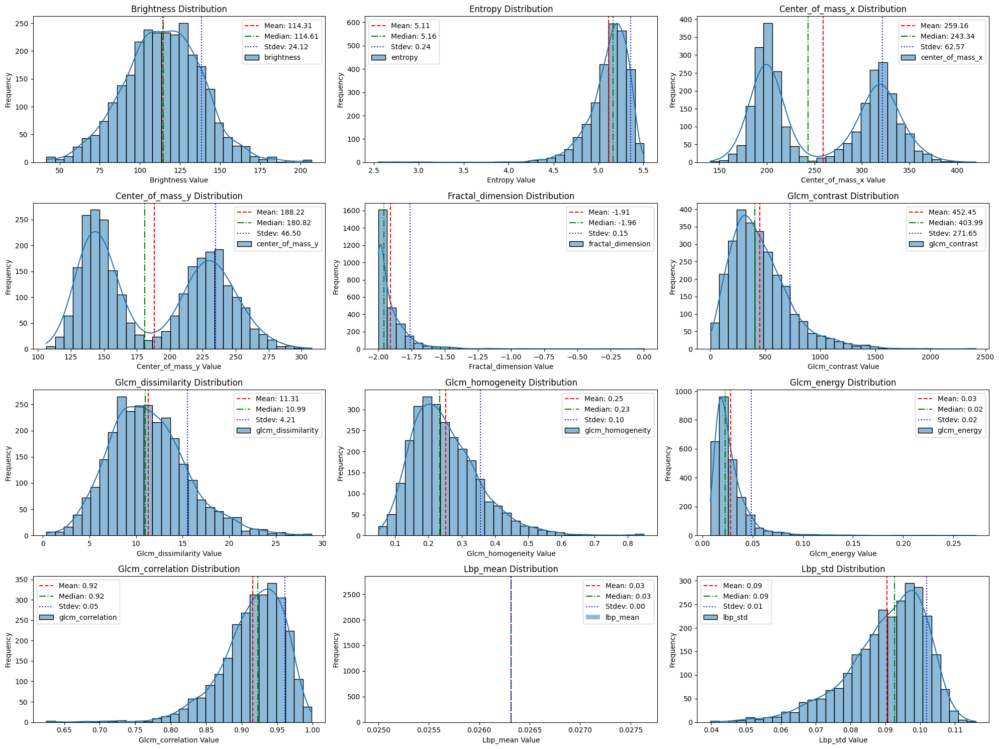

In [19]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Normalize the features using Min-Max Scaling
scaler = MinMaxScaler()
normalized_features = features_df1[[
    'brightness', 'entropy', 'center_of_mass_x', 'center_of_mass_y',
    'fractal_dimension', 'glcm_contrast', 'glcm_dissimilarity',
    'glcm_homogeneity', 'glcm_energy', 'glcm_correlation', 'lbp_mean', 'lbp_std'
]]
normalized_features_scaled = scaler.fit_transform(normalized_features)
normalized_features_df = pd.DataFrame(normalized_features_scaled, columns=normalized_features.columns)

# Investigate outliers in entropy and fractal_dimension
entropy_outliers = features_df1[features_df1['entropy'] > features_df1['entropy'].quantile(0.99)]
fractal_dimension_outliers = features_df1[features_df1['fractal_dimension'] > features_df1['fractal_dimension'].quantile(0.99)]

# Visualize feature distributions with mean, median, and std annotations
plt.figure(figsize=(20, 15))
for idx, column in enumerate([
    "brightness", "entropy", "center_of_mass_x", "center_of_mass_y",
    "fractal_dimension", "glcm_contrast", "glcm_dissimilarity",
    "glcm_homogeneity", "glcm_energy", "glcm_correlation", "lbp_mean", "lbp_std"
], 1):
    plt.subplot(4, 3, idx)
    sns.histplot(features_df1[column], kde=True, bins=30, label=column)
    
    # Annotations
    mean_val = features_df1[column].mean()
    median_val = features_df1[column].median()
    std_val = features_df1[column].std()
    plt.axvline(mean_val, color='red', linestyle='--', label=f'Mean: {mean_val:.2f}')
    plt.axvline(median_val, color='green', linestyle='-.', label=f'Median: {median_val:.2f}')
    plt.axvline(mean_val + std_val, color='blue', linestyle=':', label=f'Stdev: {std_val:.2f}')
    
    plt.title(f'{column.capitalize()} Distribution')
    plt.xlabel(f'{column.capitalize()} Value')
    plt.ylabel('Frequency')
    plt.legend()

plt.tight_layout()
plt.show()


## **Image Preprocessing**

### Features Extracted

1. Brightness  
2. Entropy  
3. Shape Features  
4. Image Properties:
   - Sharpness  
   - Edge Density  
   - Saturation  
5. Color Histogram Features  
6. Center of Mass  
7. GLCM Features:
   - Contrast  
   - Dissimilarity  
   - Homogeneity  
   - Energy  
   - Correlation  
8. Dominant Colors and Frequencies  
9. Fractal Dimension  
10. Flattened Feature Vector  


In [20]:
import numpy as np
import pandas as pd
from PIL import Image

# Remove function definition to directly process the data here
image_data_total = []
for item in preprocessed_images:
    try:
        # Extract image path and features from preprocessed data
        image_filename = item['image_name']
        image_path = item['image_path']
        city = item['city']
        
        #print(f"Processing image: {image_filename}")
        
        # Load the image and extract features
        img = Image.open(image_path)
        
        # Extract features
        brightness = get_image_brightness(image_path)
        entropy_value = calculate_entropy(image_path)
        
        # Shape features (replace with your shape features function)
        shape_feats = shape_features(img)
        
        # Analyze image properties (sharpness, edge density, saturation)
        image_properties = analyze_image_properties(image_path)
        sharpness = image_properties['sharpness']
        edge_density = image_properties['edge_density']
        saturation = image_properties['saturation']
        
        # Color histogram features
        img_array = np.array(img)
        color_hist = color_histogram(img_array)
        
        # Calculate Center of Mass
        center_x, center_y = calculate_center_of_mass(image_path)
        
        # Extract GLCM features (contrast, dissimilarity, homogeneity, energy, correlation)
        contrast, dissimilarity, homogeneity, energy, correlation = glcm_features(image_path)
        
        # Check if any GLCM features are None (skip this image if so)
        if contrast is None or dissimilarity is None or homogeneity is None or energy is None or correlation is None:
            print(f"Skipping image {image_path} due to missing GLCM features.")
            continue
        
        dominant_colors, dominant_frequencies = extract_dominant_colors(img_array, k=7)
        
        # Check if the dominant colors are returned (if it's None or empty, skip the image)
        if dominant_colors is None or len(dominant_colors) == 0:
            print(f"Skipping image {image_path} due to missing dominant colors.")
            continue

        # Calculate fractal dimension
        fractal = fractal_dimension(image_path)
        
        # Flatten and combine all features into a single feature vector
        feature_vector = np.concatenate([ 
            shape_feats, color_hist, 
            [brightness], [entropy_value], 
            [sharpness], [edge_density], 
            [saturation], [center_x], [center_y], 
            [contrast], [dissimilarity], [homogeneity], [energy], [correlation], 
            dominant_colors.flatten(), dominant_frequencies.flatten(),
            [fractal]     
        ])
        
        # Store the features with metadata
        image_data_total.append({
            'city': city,
            'image_name': image_filename,
            'brightness': brightness,
            'entropy': entropy_value,
            'sharpness': sharpness,
            'edge_density': edge_density,
            'saturation': saturation,
            'center_x': center_x,
            'center_y': center_y,
            'contrast': contrast,
            'dissimilarity': dissimilarity,
            'homogeneity': homogeneity,
            'energy': energy,
            'correlation': correlation,
            'dominant_colors': dominant_colors.flatten(),  
            'dominant_frequencies': dominant_frequencies.flatten(), 
            'fractal_dimension': fractal, 
            'features': feature_vector  
        })
    
    except Exception as e:
        print(f"Error processing image {image_filename}: {e}")

# Convert the image_data into a DataFrame
image_df = pd.DataFrame(image_data_total)

In [21]:
import numpy as np
import pandas as pd
from PIL import Image

# Function to preprocess image and extract features
def preprocess_image_cv2_correct(image_path):
    try:
        # Directly load the image without resizing or cropping
        img = Image.open(image_path)
        
        # Extract features
        brightness = get_image_brightness(image_path)
        entropy_value = calculate_entropy(image_path)
        
        # Shape features (replace with your shape features function)
        shape_feats = shape_features(img)
        
        # Analyze image properties (sharpness, edge density, saturation)
        image_properties = analyze_image_properties(image_path)
        sharpness = image_properties['sharpness']
        edge_density = image_properties['edge_density']
        saturation = image_properties['saturation']
        
        # Color histogram features
        img_array = np.array(img)
        color_hist = color_histogram(img_array)
        
        # Calculate Center of Mass
        center_x, center_y = calculate_center_of_mass(image_path)
        
        # Extract GLCM features (contrast, dissimilarity, homogeneity, energy, correlation)
        contrast, dissimilarity, homogeneity, energy, correlation = glcm_features(image_path)
        
        # Check if any GLCM features are None (skip this image if so)
        if contrast is None or dissimilarity is None or homogeneity is None or energy is None or correlation is None:
            print(f"Skipping image {image_path} due to missing GLCM features.")
            return None
        
        dominant_colors, dominant_frequencies = extract_dominant_colors(img_array, k=7)
        
        # Check if the dominant colors are returned (if it's None or empty, skip the image)
        if dominant_colors is None or len(dominant_colors) == 0:
            print(f"Skipping image {image_path} due to missing dominant colors.")
            return None
        
        # Calculate fractal dimension
        fractal = fractal_dimension(image_path)
        
        # Flatten and combine all features into a single feature vector
        feature_vector = np.concatenate([ 
            shape_feats, color_hist, 
            [brightness], [entropy_value], 
            [sharpness], [edge_density], 
            [saturation], [center_x], [center_y], 
            [contrast], [dissimilarity], [homogeneity], [energy], [correlation], 
            dominant_colors.flatten(), dominant_frequencies.flatten(),  # Flatten the RGB values if necessary
            [fractal]  
        ])
        
        return feature_vector

    except Exception as e:
        print(f"Error processing image {image_path}: {e}")
        return None

# Process dataset and extract features into a list of dictionaries
image_data_s = []
for item in preprocessed_images:
    try:
        # Extract image path and features from preprocessed data
        image_filename = item['image_name']
        image_path = item['image_path']
        
        #print(f"Processing image: {image_filename}")
        
        # Preprocess the image and extract features
        features = preprocess_image_cv2_correct(image_path)
        
        if features is not None:
            image_data_s.append({
                'city': item['city'],
                'image_name': image_filename,
                'features': features
            })
        else:
            print(f"Skipping image: {image_filename}")
            
    except Exception as e:
        print(f"Error processing image {image_filename}: {e}")

# Convert image_data into a format usable for clustering (array of features)
images_s = np.array([item['features'] for item in image_data_s])
images_s = np.array(images_s, dtype=np.float32)

print(f"Original feature shape: {images_s.shape}")


Original feature shape: (2728, 1409)


### PCA and KMeans Clustering

- **PCA (Principal Component Analysis)**:
  PCA is a dimensionality reduction technique used to reduce the number of features while retaining as much variance as possible in the dataset. It transforms the data into a new coordinate system based on the directions of maximum variance, known as principal components.
  
  In the code, we apply PCA with 3 components (`n_components=3`). This choice is based on the **explained variance ratio**. We calculate the cumulative variance and select the number of components that explain at least 95% of the total variance. If the optimal number of components (for 95% variance) is 3, it indicates that using 3 components provides a sufficiently reduced representation of the data without losing significant information.

- **KMeans Clustering**:
  KMeans is an unsupervised machine learning algorithm used to partition the data into `k` clusters. It tries to minimize the variance within each cluster and groups similar data points together. 

  In the code, we use KMeans to cluster the data after applying PCA for dimensionality reduction. The number of clusters (`k=9`) is a parameter that can be adjusted based on the data. The algorithm uses the reduced 3D feature space to identify distinct clusters in the dataset.

  The KMeans algorithm is initialized with:
  - **`n_init=10`**: The number of times the KMeans algorithm will run with different initializations to find the optimal clustering.
  - **`max_iter=4000`**: The maximum number of iterations to refine the clusters.
  - **`tol=1e-5`**: The tolerance for convergence. The algorithm stops if the improvement between iterations is smaller than this value.


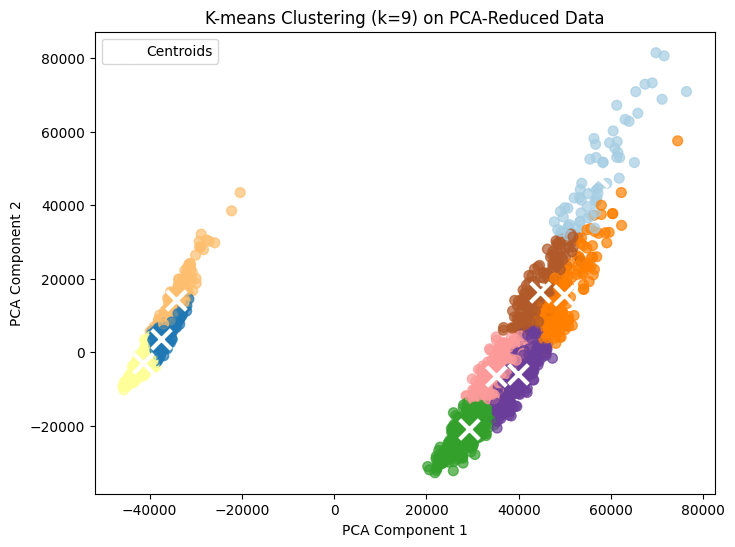

Silhouette Score: 0.3599911332130432


In [57]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split

# Apply PCA to reduce dimensionality to 2D
pca = PCA(n_components=3)
reduced_data = pca.fit_transform(images_s)

# Apply KMeans clustering
k =9# Adjust the number of clusters as necessary
kmeans = KMeans(n_clusters=k, init='random', n_init=10, max_iter=4000, tol=1e-5, random_state=42)
kmeans.fit(reduced_data)

# Get cluster labels
cluster_labels = kmeans.labels_

# Step 4: Plot the clustering results
plt.figure(figsize=(8, 6))

# Create a scatter plot of the PCA-reduced data points, colored by their cluster label
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=cluster_labels, cmap=plt.cm.Paired, marker='o', s=50, alpha=0.7)
# Plot the centroids of the clusters
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], marker='x', s=200, linewidths=3, color='w', zorder=10, label='Centroids')

plt.title(f'K-means Clustering (k={k}) on PCA-Reduced Data')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')

# Display legend
plt.legend()

# Show the plot
plt.show()

# Optional: Evaluate Clustering (Silhouette Score)
train_silhouette = silhouette_score(reduced_data, cluster_labels)
print(f"Silhouette Score: {train_silhouette}")


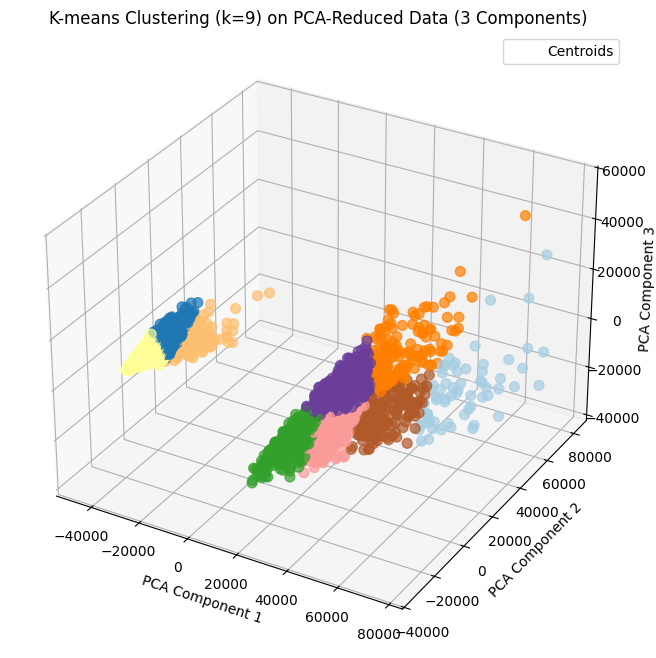

In [23]:
from mpl_toolkits.mplot3d import Axes3D

# Plot the clustering results in 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(
    reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2],
    c=cluster_labels, cmap=plt.cm.Paired, marker='o', s=50, alpha=0.7
)

# Plot centroids
centroids = kmeans.cluster_centers_
ax.scatter(
    centroids[:, 0], centroids[:, 1], centroids[:, 2],
    marker='x', s=200, linewidths=3, color='w', zorder=10, label='Centroids'
)

# Set labels and title
ax.set_title(f'K-means Clustering (k={k}) on PCA-Reduced Data (3 Components)')
ax.set_xlabel('PCA Component 1')
ax.set_ylabel('PCA Component 2')
ax.set_zlabel('PCA Component 3')

plt.legend()
plt.show()

In [24]:
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
d_optimal = np.argmax(cumulative_variance >= 0.95) + 1
print(f"Number of components explaining 95% variance: {d_optimal}")

Number of components explaining 95% variance: 3


### Silhouette Score

- **KMeans Clustering with Silhouette Score**:
  To determine the optimal number of clusters (`k`), we use the **Silhouette Score**, which evaluates the quality of the clustering. A higher Silhouette Score indicates that the clusters are well-separated and compact. The algorithm iterates through a range of `k` values (from 2 to 14) and calculates the Silhouette Score for each value.
  
  - **Silhouette Score**: Measures how similar an object is to its own cluster compared to other clusters. A score close to +1 indicates well-defined clusters, 0 indicates overlapping clusters, and negative scores suggest misclassified points.
  
  By plotting the silhouette scores for different `k` values, we can visually identify the optimal number of clusters, where the score is maximized, indicating the best clustering configuration.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Determine the optimal number of clusters using the entire datases

# Determine the best `k` using the entire dataset
k_values = range(2, 15)
silhouette_scores = []
for k in k_values:
    kmeans = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=4000, tol=1e-5, random_state=42)
    labels = kmeans.fit_predict(reduced_data)
    silhouette = silhouette_score(reduced_data, labels)
    silhouette_scores.append(silhouette)

# Plot silhouette scores to find the optimal k
plt.figure(figsize=(8, 6))
plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs. Number of Clusters')
plt.show()


In [27]:
image_df['cluster'] = cluster_labels

In the heatmap generated by the below code, we can observe the normalized proportions of images in each cluster for each city. The key points we see in the graph are:

Each row represents a different city, and each column represents a cluster.
The color intensity indicates the proportion of images from each city that belong to each cluster, with darker colors indicating a higher proportion.
The numbers in each cell show the exact normalized proportion of images from a particular city that belong to a particular cluster.

**Cluster distribution: This heatmap helps identify which clusters are dominant in each city. 
Overall, the heatmap provides insight into how similar or different the cities are based on their image characteristics, as reflected in the clusters.**

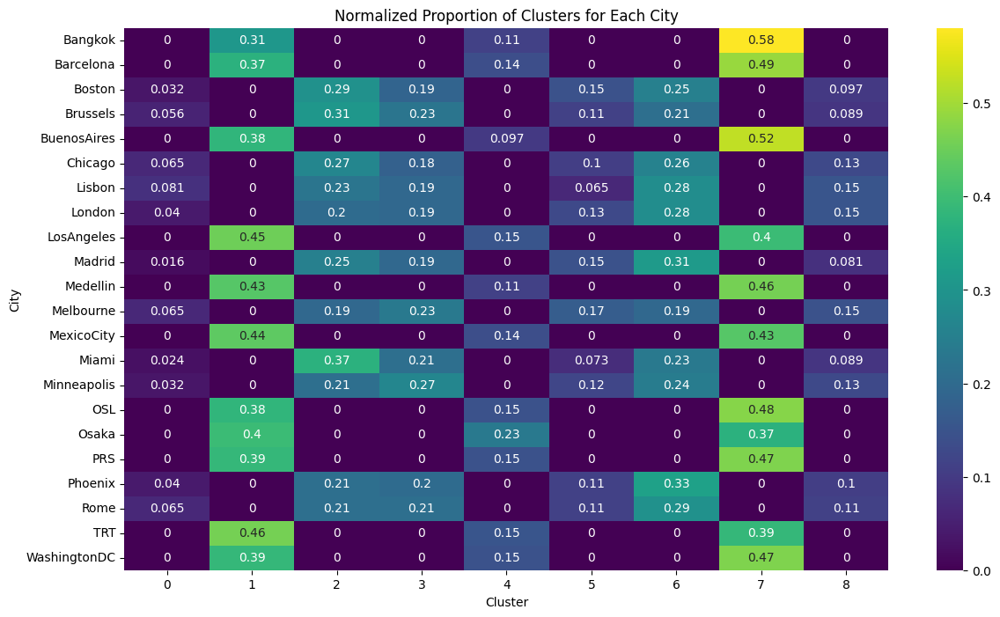

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt

# Group by city and cluster to get the count of images in each cluster for each city
city_cluster_counts = image_df.groupby(['city', 'cluster']).size().unstack(fill_value=0)

# Normalize to get the proportion of images in each cluster for each city
city_cluster_proportions = city_cluster_counts.div(city_cluster_counts.sum(axis=1), axis=0)

# Plot the normalized proportions of clusters for all cities using a heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(city_cluster_proportions, annot=True, cmap='viridis')
plt.title('Normalized Proportion of Clusters for Each City')
plt.xlabel('Cluster')
plt.ylabel('City')
plt.show()


#### Visualize the Distribution of Cities Across Clusters

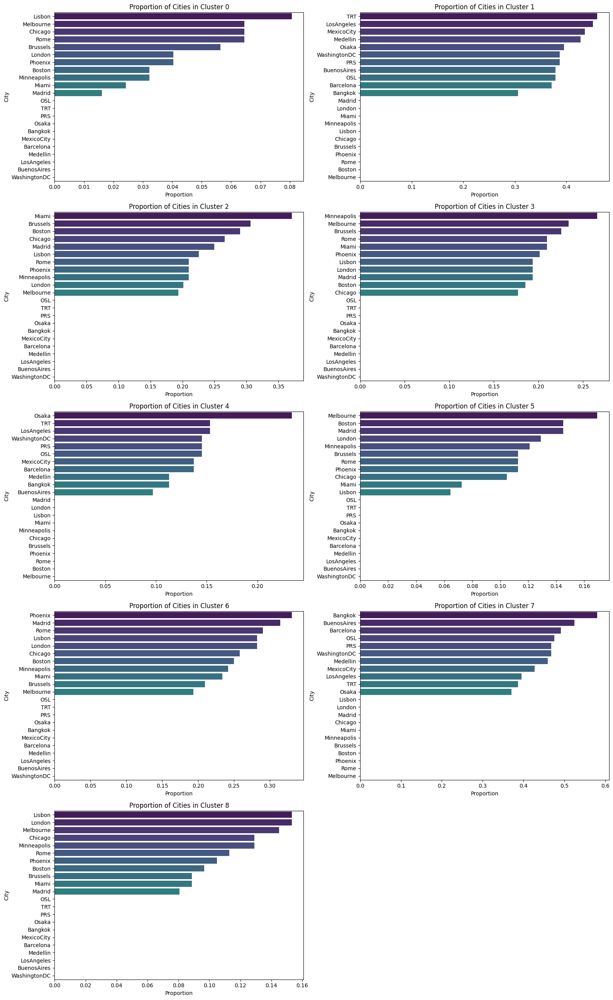

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import math

warnings.filterwarnings('ignore')

# Plot for each cluster separately
clusters = city_cluster_proportions.columns

# Calculate the number of rows and columns for the subplots
num_clusters = len(clusters)
num_rows = math.ceil(num_clusters / 2)  # Ensure all clusters have a plot
num_cols = 2  # We set the number of columns to 2

# Create the subplots
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(16, 26))
axes = axes.flatten()  # Flatten the 2D array of axes into 1D for easy iteration

# Loop through each cluster and plot
for i, cluster in enumerate(clusters):
    city_proportions = city_cluster_proportions[cluster].sort_values(ascending=False)
    sns.barplot(x=city_proportions.values, y=city_proportions.index, ax=axes[i], palette='viridis')
    axes[i].set_title(f'Proportion of Cities in Cluster {cluster}')
    axes[i].set_xlabel('Proportion')
    axes[i].set_ylabel('City')

# Remove any empty subplots if the grid is larger than the number of clusters
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


The code below calculates the **pairwise Euclidean distances** between cities based on the normalized proportion of images in each cluster.

**Euclidean Distance:** It uses the pdist function from `scipy.spatial.distance` to compute the Euclidean distance between the cities' cluster proportions. This distance measures how similar or different the cities are based on their distribution across clusters.

**Heatmap:** The resulting distance matrix is then converted into a DataFrame and visualized as a heatmap using `seaborn`. The heatmap shows how similar or different the cities are in terms of their clustering patterns, with color intensity representing the distance.

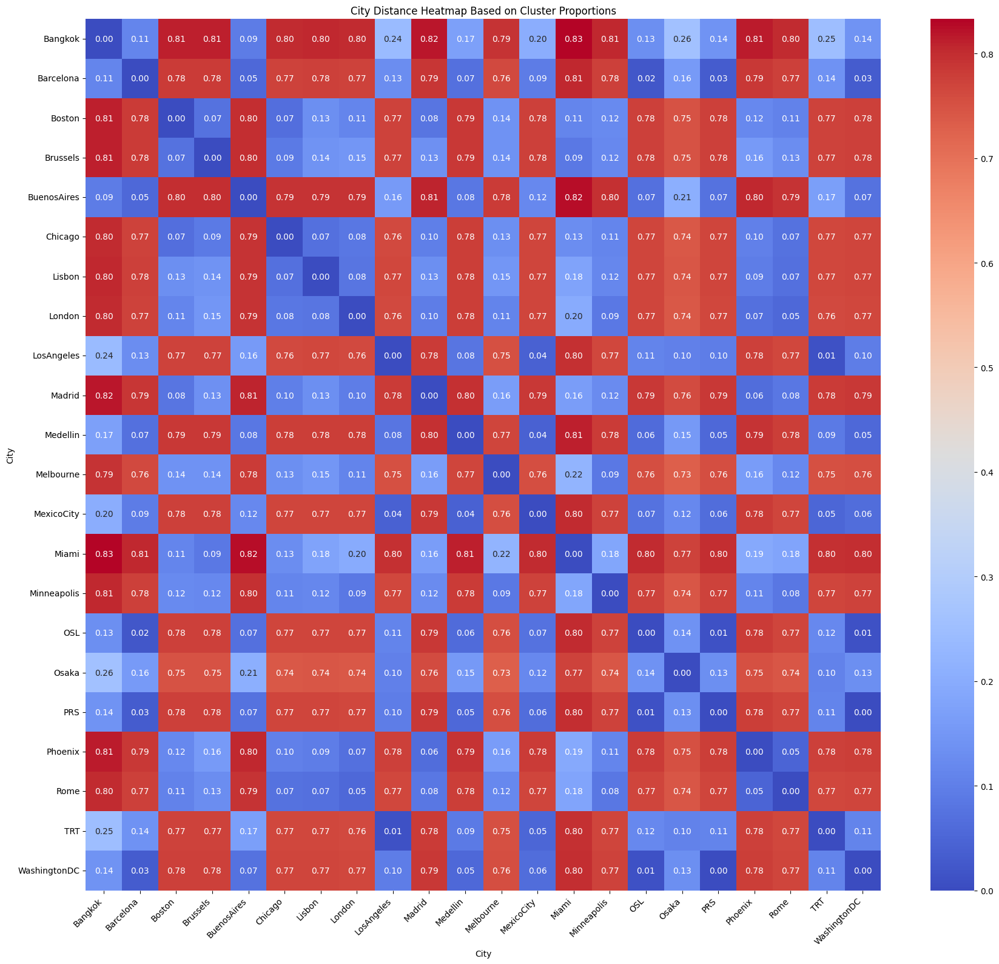

In [30]:
from scipy.spatial.distance import pdist, squareform

# Calculate pairwise Euclidean distances between cities
distance_matrix = squareform(pdist(city_cluster_proportions, metric='euclidean'))

# Convert to a DataFrame for plotting
distance_df = pd.DataFrame(distance_matrix, index=city_cluster_proportions.index, columns=city_cluster_proportions.index)

# Plot the distance heatmap
plt.figure(figsize=(18, 16))
sns.heatmap(distance_df, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('City Distance Heatmap Based on Cluster Proportions')
plt.xlabel('City')
plt.ylabel('City')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


### Cosine Similarity Heatmap for Cities in Clusters

- **Threshold for Proportions**: A threshold (e.g., 0.1) is applied to filter cities that have significant proportions in each cluster. This ensures that only cities with relevant representations in the cluster are considered for comparison.

- **Cosine Similarity**: For each cluster, the code calculates the pairwise cosine similarity between cities. Cosine similarity measures the similarity of two vectors based on their orientation (ignoring their magnitude), which is useful for comparing the cluster proportions of different cities.

- **Heatmap Visualization**: The similarity matrix is visualized as a heatmap where color intensity represents the degree of similarity between cities. The plot provides insight into how cities relate to each other in terms of their clustering patterns.

Cluster 0 has fewer than 2 cities meeting the threshold. Skipping.


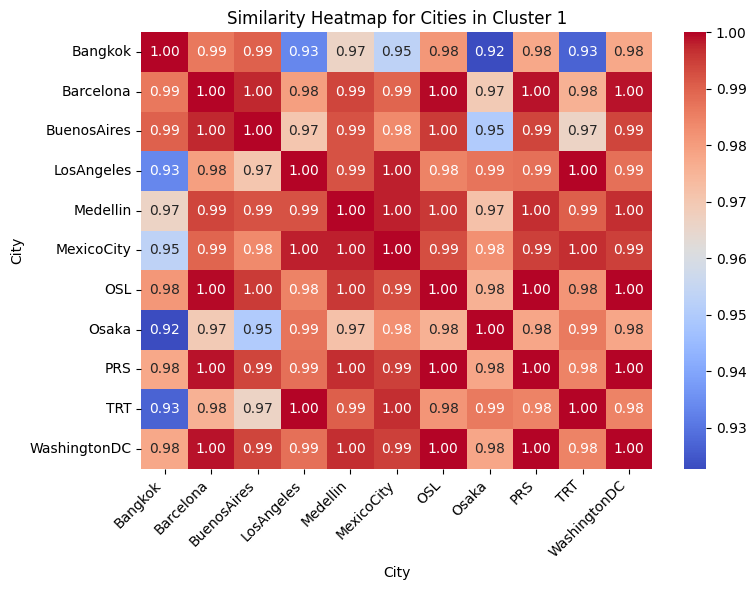

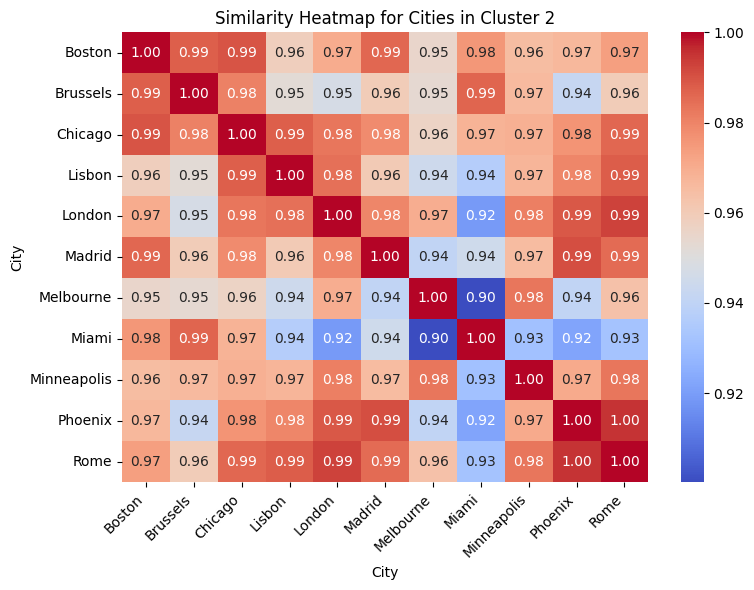

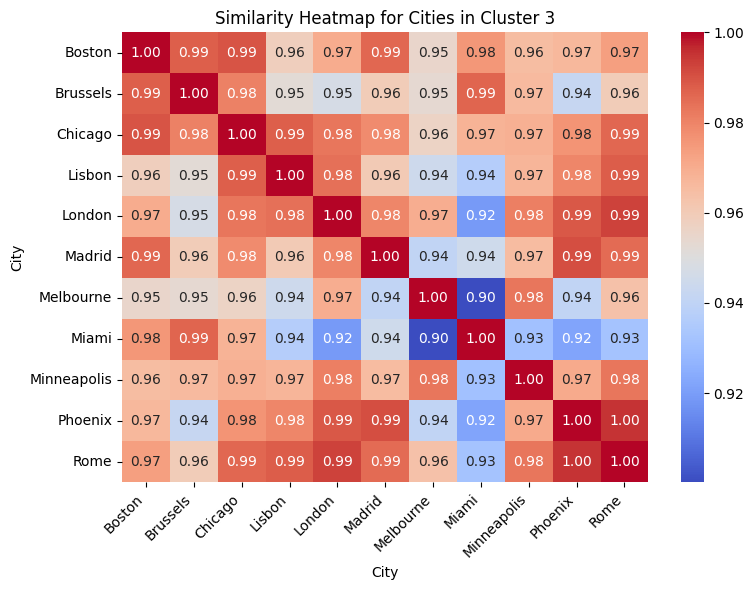

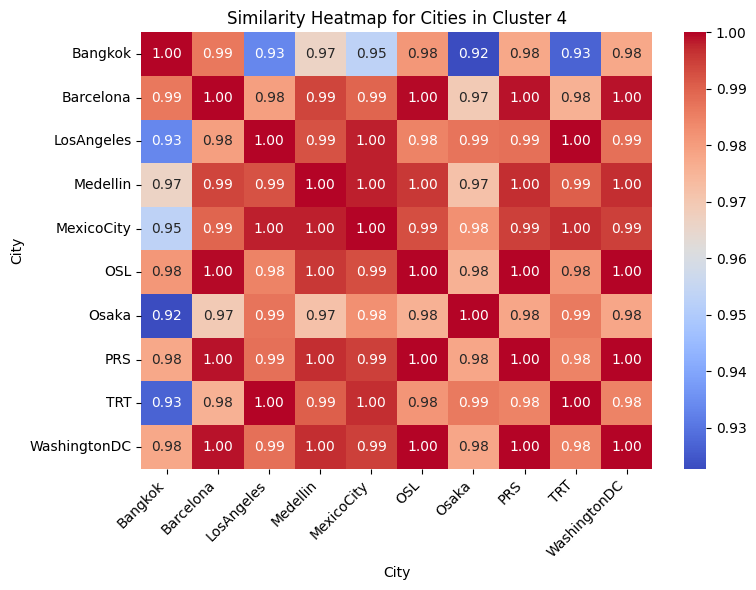

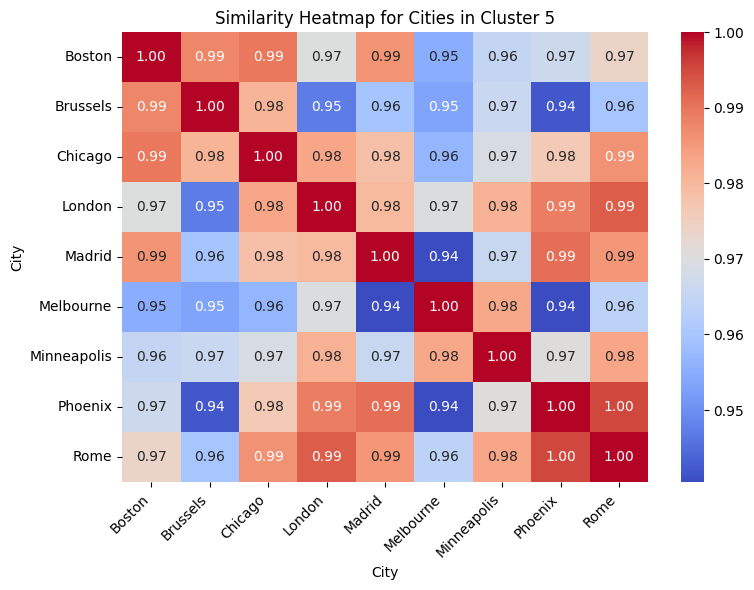

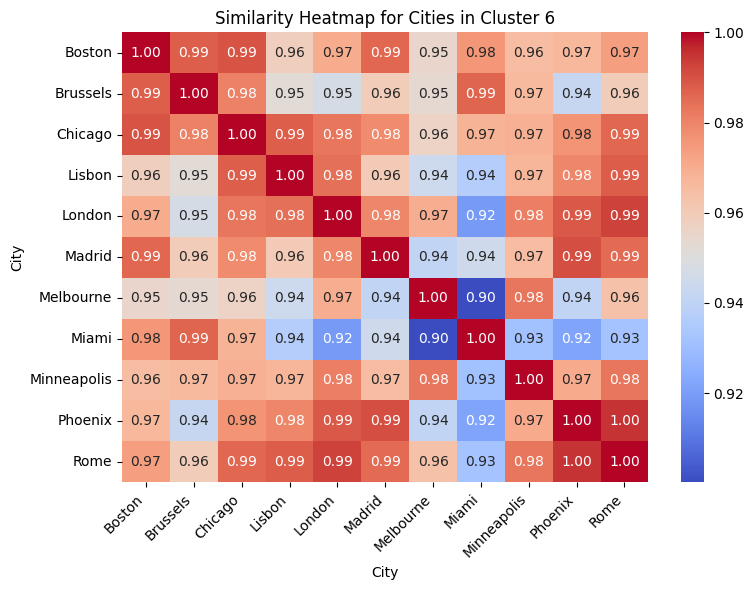

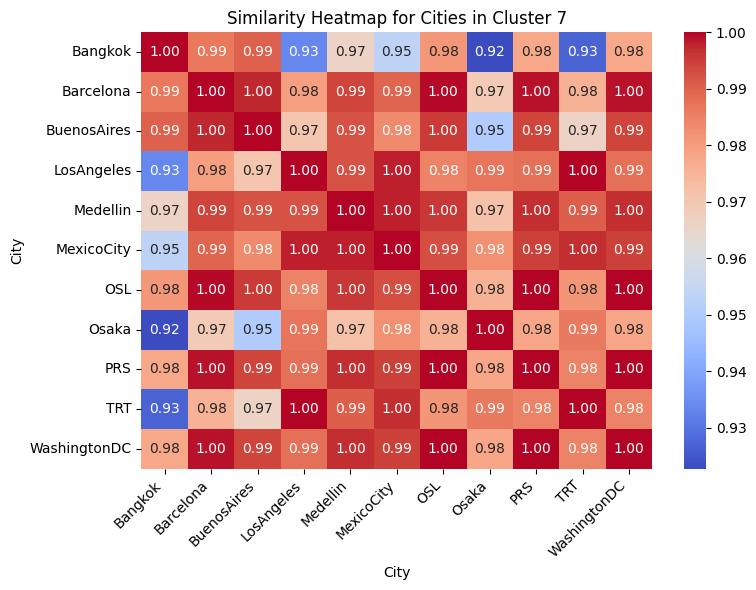

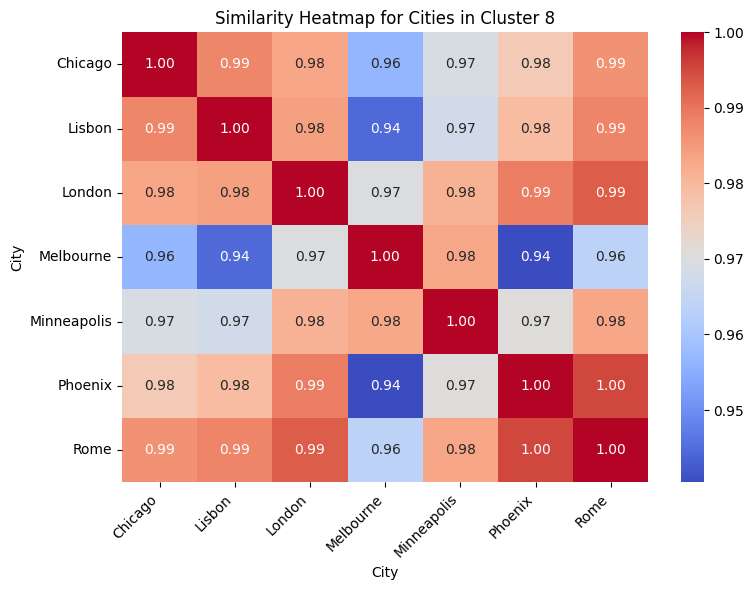

In [31]:
from sklearn.metrics.pairwise import cosine_similarity

# Define a threshold for "significant" proportions
threshold = 0.1  

# Loop through each cluster
for cluster in city_cluster_proportions.columns:
    # Filter cities based on the current cluster
    relevant_cities = city_cluster_proportions[city_cluster_proportions[cluster] > threshold].index

    if len(relevant_cities) > 1:  # Ensure there are enough cities for comparison
        # Subset proportions to only relevant cities
        subset_proportions = city_cluster_proportions.loc[relevant_cities]

        # Calculate similarity matrix
        similarity_matrix = cosine_similarity(subset_proportions)
        similarity_df = pd.DataFrame(
            similarity_matrix, index=subset_proportions.index, columns=subset_proportions.index
        )

        #  Plot a heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(similarity_df, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
        plt.title(f'Similarity Heatmap for Cities in Cluster {cluster}')
        plt.xlabel('City')
        plt.ylabel('City')
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()
    else:
        print(f"Cluster {cluster} has fewer than 2 cities meeting the threshold. Skipping.")



### Barplots of Feature Means per Cluster

- **Visualization of Cluster-wise Feature Means**: These plots show the mean values of various features across different clusters, helping to interpret the characteristics of each cluster.

1. **Features**:
   - **Cluster-wise Means for Contrast and Sharpness**: Highlights the average contrast and sharpness values for each cluster.
   - **Cluster-wise Means for Brightness, Saturation, Center_X, and Center_Y**: Explores spatial and color properties of images within clusters.
   - **Cluster-wise Means for Entropy, Dissimilarity, and Fractal Dimension**: Focuses on textural and structural properties across clusters.
   - **Cluster-wise Means for Edge Density, Homogeneity, Energy, and Correlation**: Provides insight into texture and edge properties for cluster differentiation.

2. **Purpose**:
   - Identify distinct feature patterns within clusters.
   - Understand how features contribute to clustering.
   - Compare cluster-specific characteristics for better interpretation.

3. **Visualization Details**:
   - Each bar represents the mean value of a feature for a specific cluster.
   - Hue indicates the cluster, allowing easy comparison across features.
   - Rotated x-axis labels ensure readability.

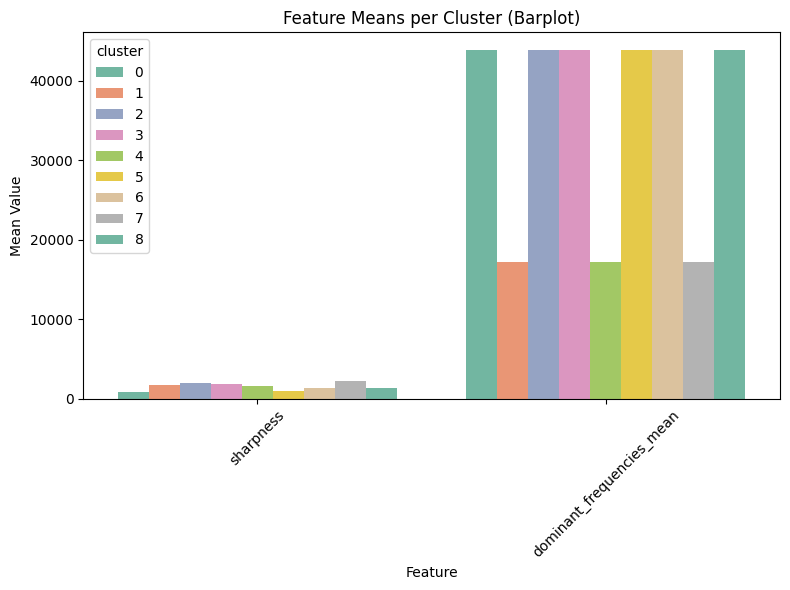

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Create new columns to summarize dominant_colors and dominant_frequencies
image_df['dominant_colors_mean'] = image_df['dominant_colors'].apply(lambda x: np.mean(x) if isinstance(x, (list, np.ndarray)) else np.nan)
image_df['dominant_frequencies_mean'] = image_df['dominant_frequencies'].apply(lambda x: np.mean(x) if isinstance(x, (list, np.ndarray)) else np.nan)

melted_df1 = pd.melt(image_df, id_vars=['cluster'], value_vars=[
     'sharpness','dominant_frequencies_mean'
], var_name='Feature', value_name='Value')

# Plot a barplot for feature means per cluster
plt.figure(figsize=(8, 6))
sns.barplot(x='Feature', y='Value', hue='cluster', data=melted_df1, ci=None, palette="Set2")

# Set plot titles and labels
plt.title('Feature Means per Cluster (Barplot)')
plt.xlabel('Feature')
plt.ylabel('Mean Value')
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()

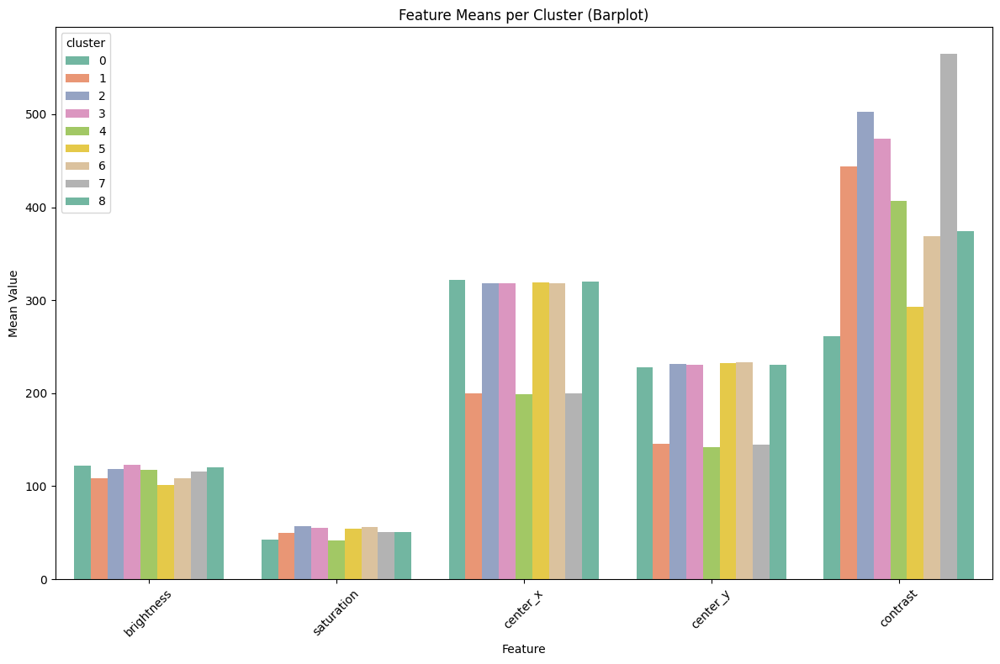

In [48]:
melted_df4 = pd.melt(image_df, id_vars=['cluster'], value_vars=[
     'brightness', 'saturation',  'center_x', 'center_y','contrast'
], var_name='Feature', value_name='Value')

# Plot a barplot for feature means per cluster
plt.figure(figsize=(12, 8))
sns.barplot(x='Feature', y='Value', hue='cluster', data=melted_df4, ci=None, palette="Set2")

# Set plot titles and labels
plt.title('Feature Means per Cluster (Barplot)')
plt.xlabel('Feature')
plt.ylabel('Mean Value')
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()

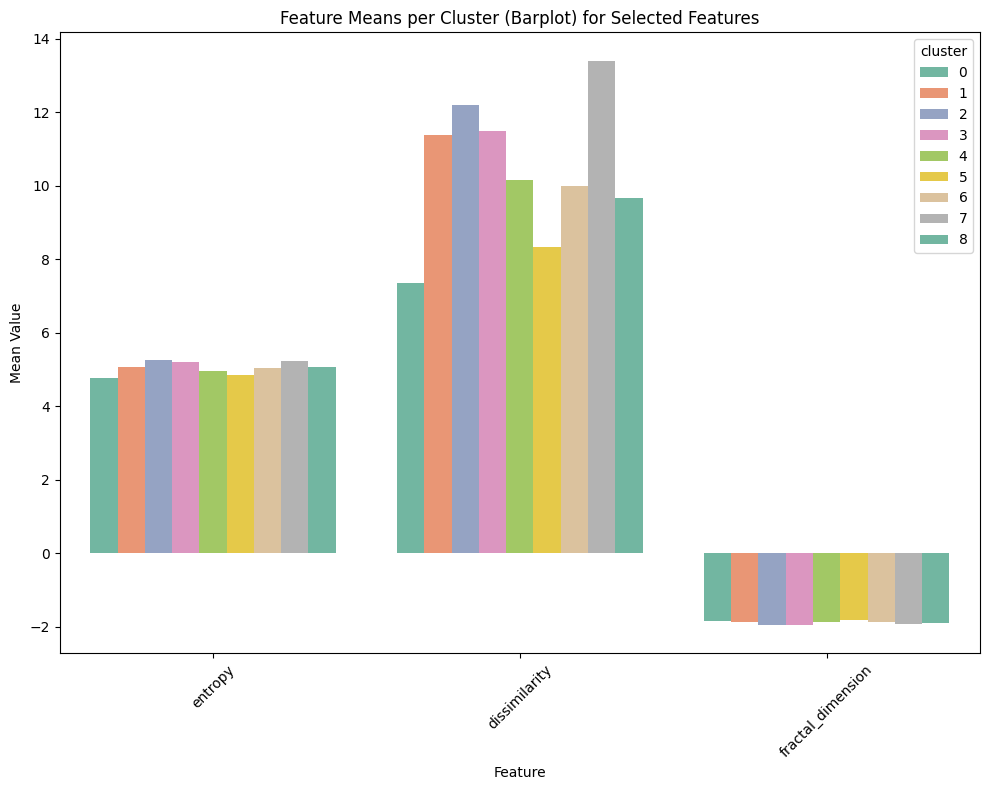

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Melt the DataFrame for easier plotting
melted_df2 = pd.melt(image_df, id_vars=['cluster'], value_vars=[
    'entropy', 'dissimilarity','fractal_dimension'
], var_name='Feature', value_name='Value')

# Plot a barplot for feature means per cluster
plt.figure(figsize=(10, 8))
sns.barplot(x='Feature', y='Value', hue='cluster', data=melted_df2, ci=None, palette="Set2")

# Set plot titles and labels
plt.title('Feature Means per Cluster (Barplot) for Selected Features')
plt.xlabel('Feature')
plt.ylabel('Mean Value')
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


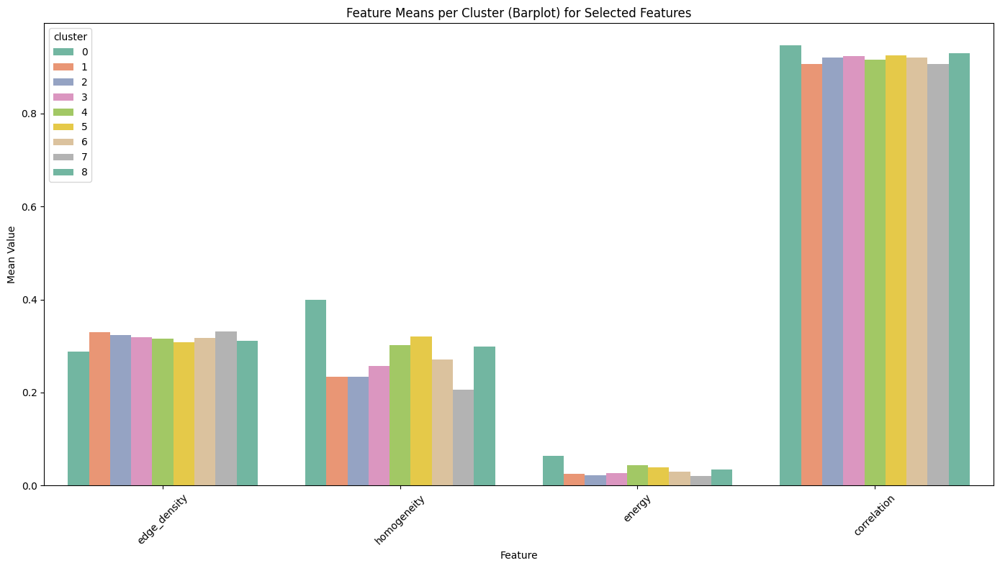

In [29]:
# Melt the DataFrame for easier plotting
melted_df3 = pd.melt(image_df, id_vars=['cluster'], value_vars=[
     'edge_density', 'homogeneity', 
    'energy', 'correlation'
], var_name='Feature', value_name='Value')

# Plot a barplot for feature means per cluster
plt.figure(figsize=(14, 8))
sns.barplot(x='Feature', y='Value', hue='cluster', data=melted_df3, ci=None, palette="Set2")

# Set plot titles and labels
plt.title('Feature Means per Cluster (Barplot) for Selected Features')
plt.xlabel('Feature')
plt.ylabel('Mean Value')
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()

### Potential Limitations and Areas for Improvement

#### Limitations
1. **Memory Constraints and Image Selection**:
   - Due to memory limitations, it was not feasible to load a large number of images simultaneously. As a result, the analysis was restricted to 124 images, corresponding to the number of available images for Athens. This limitation might have impacted the generalizability of the findings across a broader dataset.
   
2. **K-Means Clustering Parameter Restrictions**:
   - The dominant color extraction was performed using K-means clustering. However, due to memory and computational constraints, the number of clusters (`k`) was limited to 7. A higher value of `k` might have captured finer color nuances in the images, leading to a more detailed and accurate representation of the color palette.

#### Suggestions for Improvement
1. **Adopting More Efficient Color Extraction Algorithms**:
   - An alternative to K-means clustering could be **Gaussian Mixture Models (GMMs)**. GMMs are capable of modeling overlapping clusters, making them better suited for identifying soft transitions and subtle variations in color. This method would improve the identification of nuanced colors and provide a richer representation of the images' color profiles.

2. **Optimizing Memory Usage**:
   - Techniques such as image resizing or batching the image processing pipeline could allow for handling a larger dataset without exceeding memory limits. Using distributed computing platforms or cloud-based solutions might further alleviate these constraints.

3. **Experimenting with Additional Methods**:
   - Other clustering algorithms, such as **Hierarchical Clustering** or **Kernel Density Estimation**, could provide alternative perspectives and insights into the color distribution, especially in cases where capturing subtle nuances is critical.

---

## Annotation Agreement

### Purpose

The purpose of this task is to visualize the percentage agreement between multiple annotators. The annotations involve categorical evaluations of various conditions related to sidewalks and accessibility in Athens. This analysis aims to identify the consistency and reliability of the annotations provided across different files.

---

### Percentage Agreement


The percentage agreement has been calculated by:
-  Determining the percentage of matching annotations for each pair of annotators by comparing their evaluations across all categories.
-  Aggregating the matches for the selected categories to compute an overall cumulative agreement percentage.

**categories:**
 1.   **'Parked Vehicles Obstructing Sidewalks'**
 2.   **'Narrow or Limited Sidewalk Space'**
 3.   **'Uneven or Hazardous Pavement'**
 4.   **'Obstacles from Natural Elements'**
 5.   **'Miscellaneous Obstructions'**
 6.   **'Blocked or Limited Crossing Access'**
 7.   **'Debris and Environmental Hazards'**
 8.   **'Inaccesible for people with disabilities'**
 9.   **'Restaurant chairs could narrow sidewalk space'**
 10.  **'ramp inaccesible for people with disabilities due to parked cars'**

--- 
1. For each category listed in the categories, the annotations from two files are compared to check if they match.  
2. For every pair of files (annotators), the number of matching annotations across all categories is calculated.  

The agreement percentage is computed as:  

   $[
   \text{Percentage Agreement} = \left( \frac{\text{Total Matches}}{\text{Total Comparisons}} \right) \times 100
   ]$

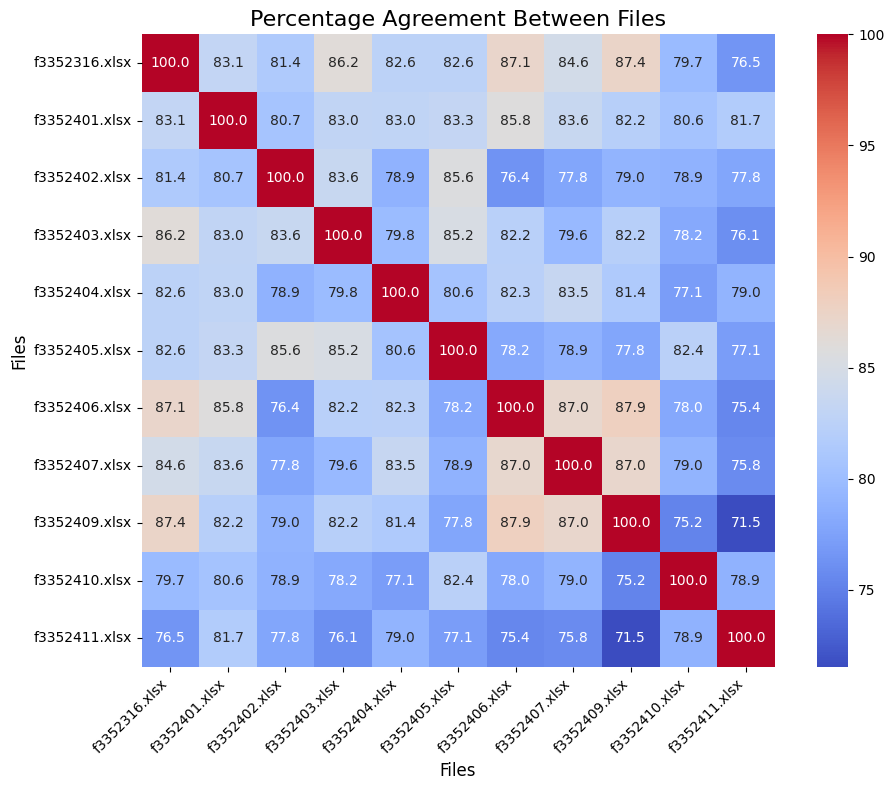

In [31]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Define the folder containing the processed files
folder_path_output = "C:/Users/maria/Desktop/c"

# Define the category columns to compare
category_columns = [
    'Parked Vehicles Obstructing Sidewalks',
    'Narrow or Limited Sidewalk Space',
    'Uneven or Hazardous Pavement',
    'Obstacles from Natural Elements',
    'Miscellaneous Obstructions',
    'Blocked or Limited Crossing Access',
    'Debris and Environmental Hazards',
    'Inaccesible for people with disabilities',
    'Restaurant chairs could narrow sidewalk space',
    'ramp inaccesible for people with disabilities due to parked cars'
]

# Load all processed Excel files into a dictionary
dataframes = {}
for file_name in os.listdir(folder_path_output):
    if file_name.endswith(".xlsx"):
        file_path = os.path.join(folder_path_output, file_name)
        try:
            # Load the Excel file into a DataFrame
            dataframes[file_name] = pd.read_excel(file_path)
        except Exception as e:
            print(f"Error reading file {file_name}: {e}")

# Ensure there are at least two files to compare
if len(dataframes) < 2:
    print("Not enough files to calculate percentage agreement.")
else:
    # Align all dataframes by their indices and columns
    aligned_data = pd.concat(dataframes.values(), axis=1, keys=dataframes.keys(), join='inner')

    # Initialize a DataFrame to store pairwise agreement
    file_names = list(dataframes.keys())
    agreement_matrix = pd.DataFrame(np.zeros((len(file_names), len(file_names))), 
                                    index=file_names, columns=file_names)

    # Calculate pairwise agreement for all files
    for i, file_a in enumerate(file_names):
        for j, file_b in enumerate(file_names):
            if i < j:  # Avoid redundant calculations
                total_agreements = 0
                total_comparisons = 0

                for category in category_columns:
                    # Extract the category data for the two files
                    if category in aligned_data[file_a].columns and category in aligned_data[file_b].columns:
                        data_a = aligned_data[file_a][category]
                        data_b = aligned_data[file_b][category]

                        # Compare the annotations for the category
                        agreements = (data_a == data_b).sum()
                        total_agreements += agreements
                        total_comparisons += len(data_a)

                # Calculate percentage agreement
                percentage_agreement = (total_agreements / total_comparisons) * 100 if total_comparisons > 0 else 0
                agreement_matrix.loc[file_a, file_b] = percentage_agreement
                agreement_matrix.loc[file_b, file_a] = percentage_agreement

    # Fill the diagonal with 100% agreement (self-agreement)
    np.fill_diagonal(agreement_matrix.values, 100)

    # Display the heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(agreement_matrix, annot=True, fmt=".1f", cmap="coolwarm", cbar=True, square=True)
    plt.title("Percentage Agreement Between Files", fontsize=16)
    plt.xlabel("Files", fontsize=12)
    plt.ylabel("Files", fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()


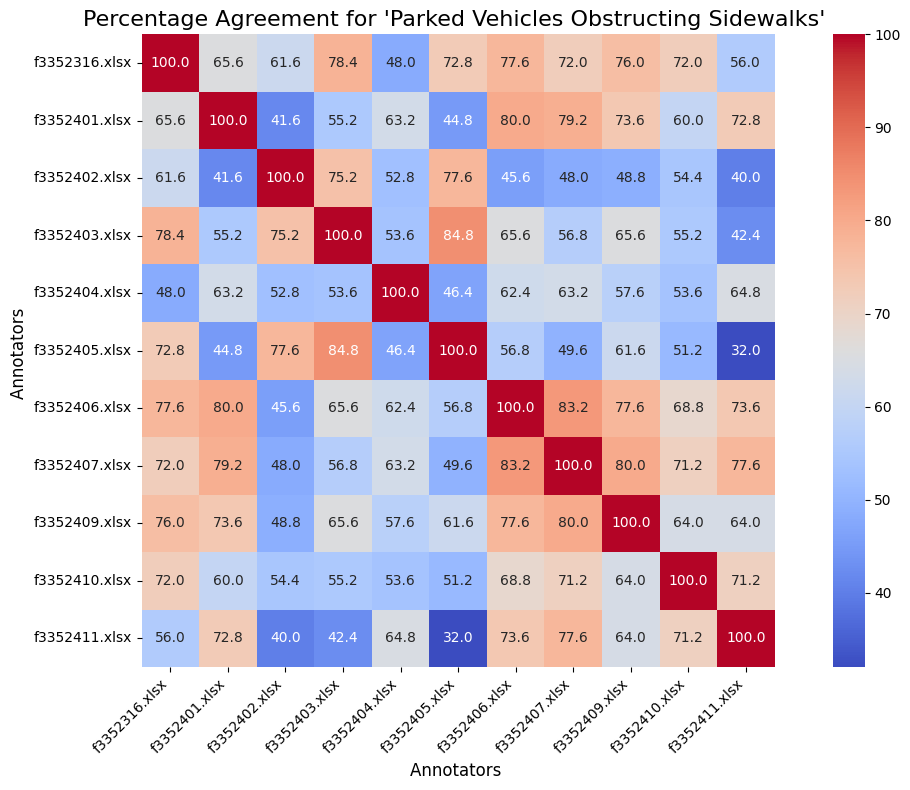

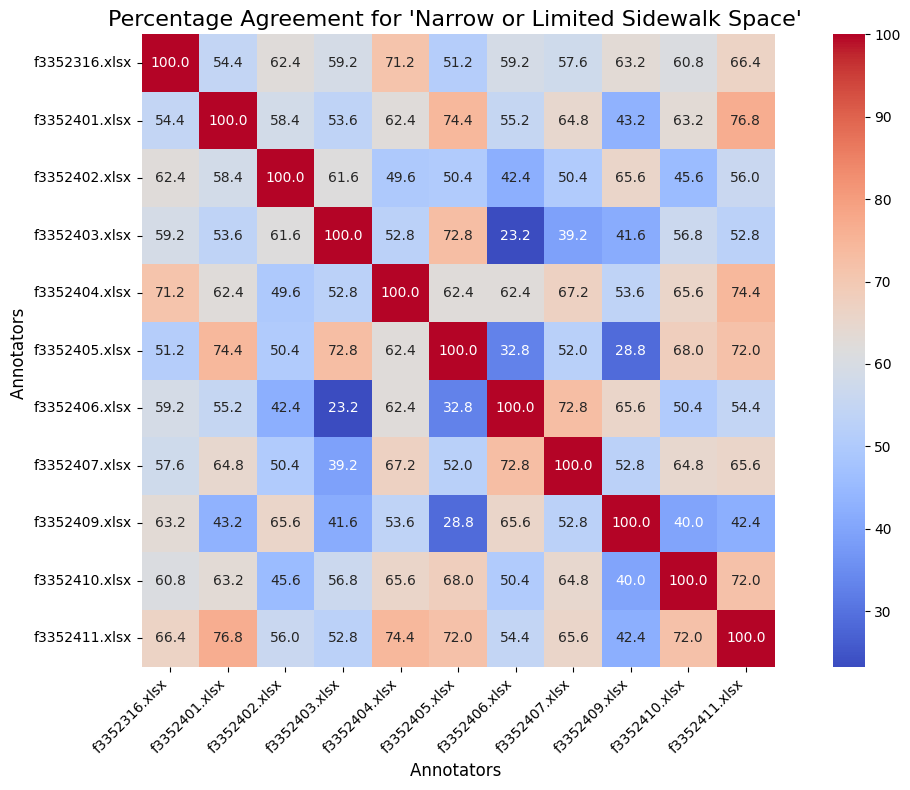

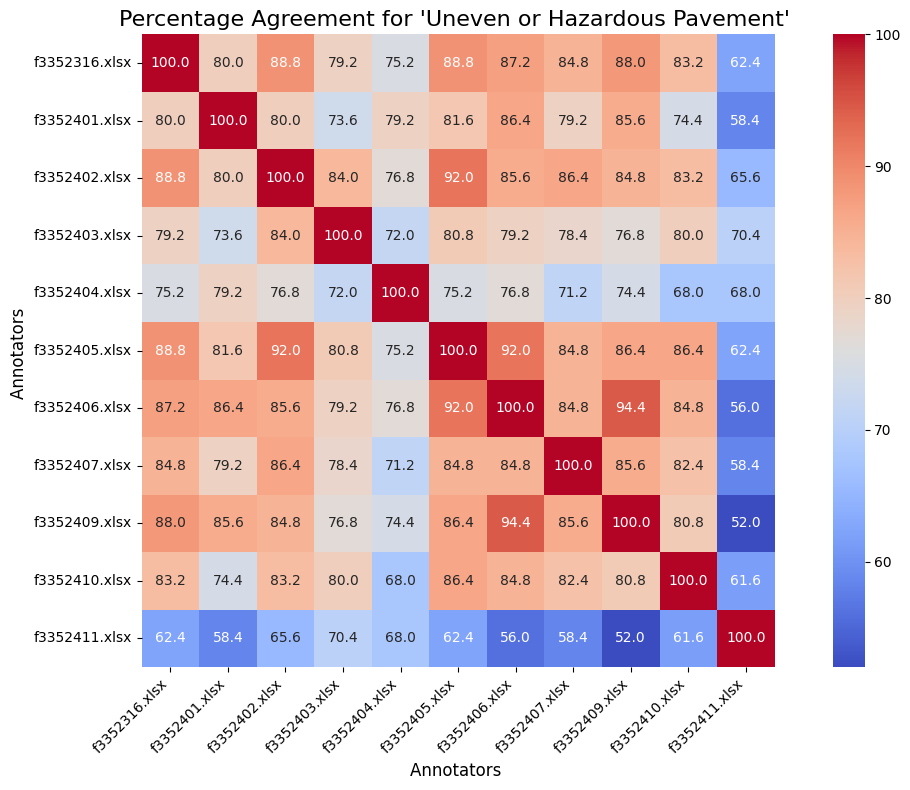

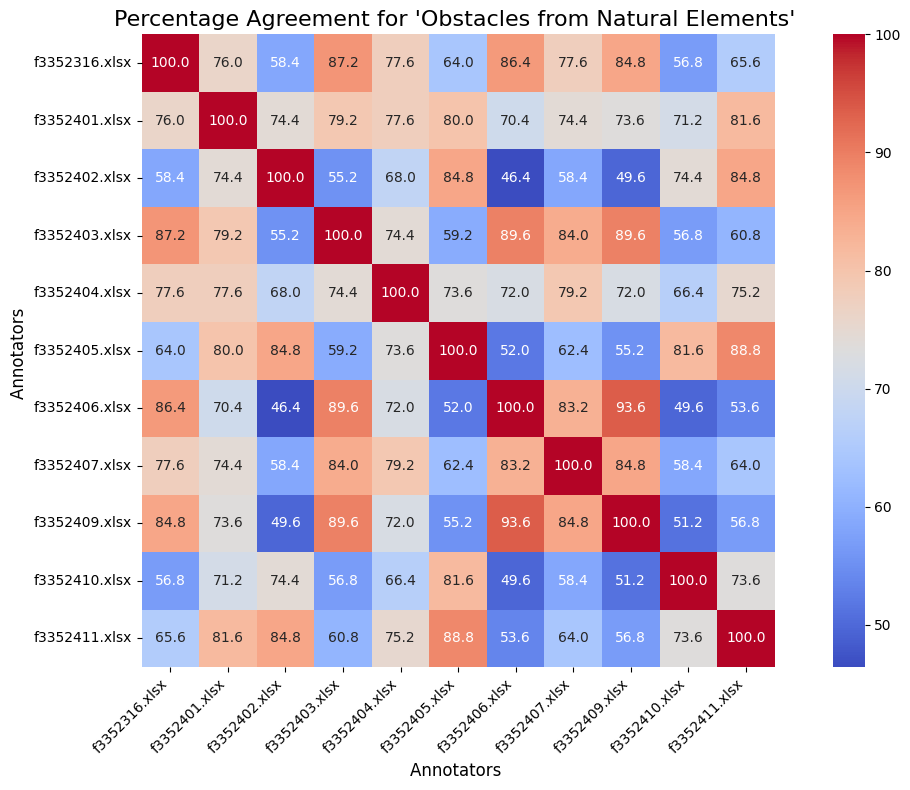

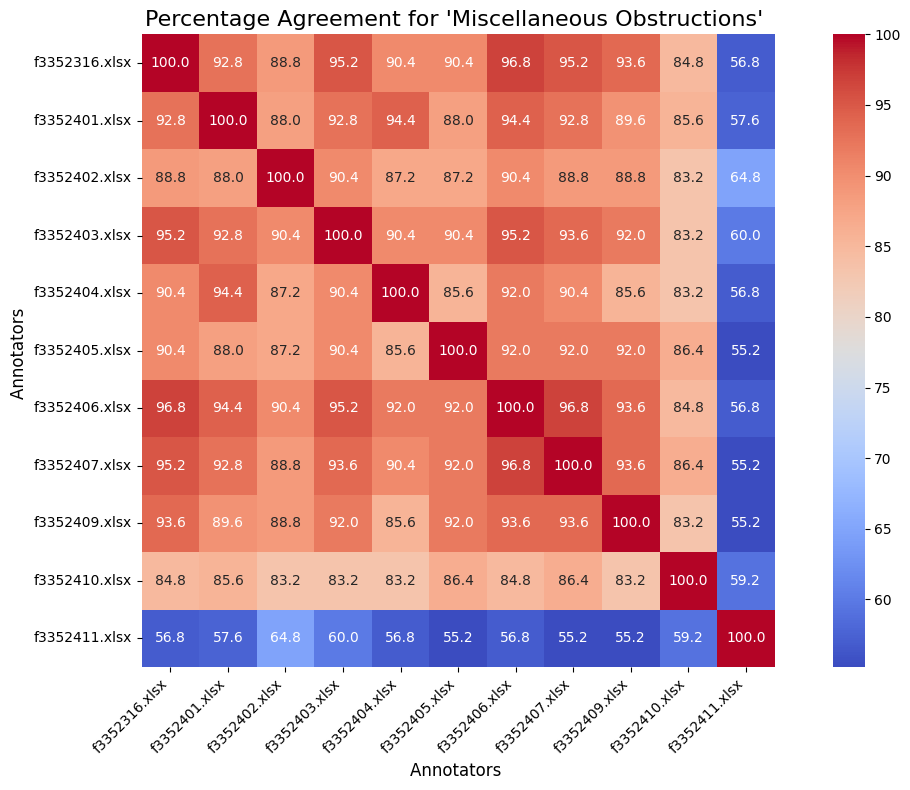

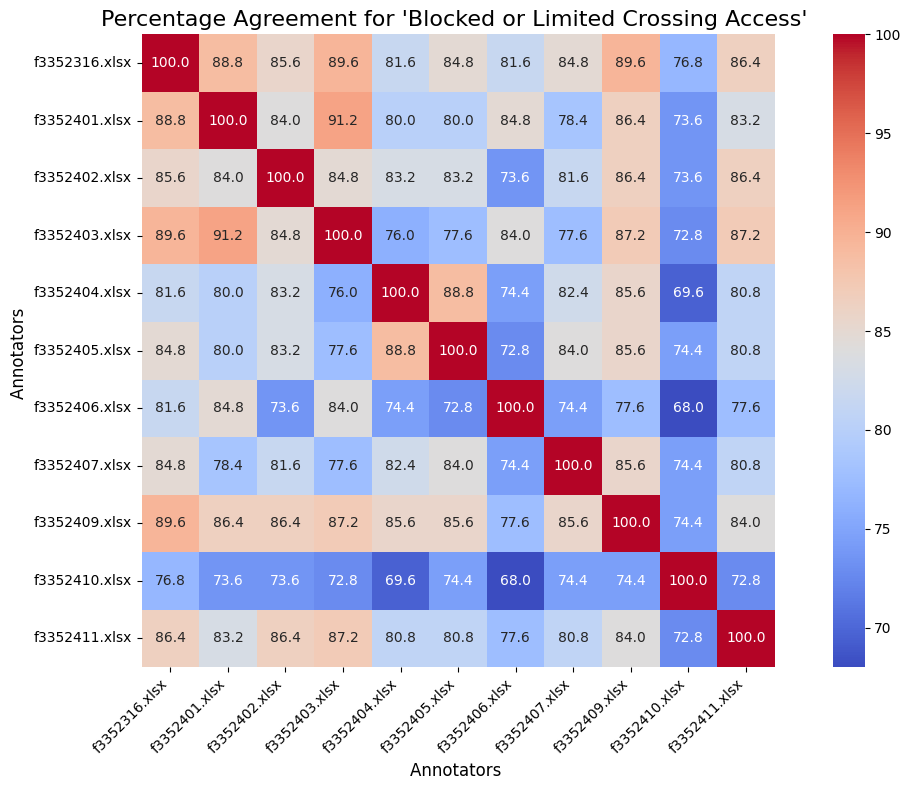

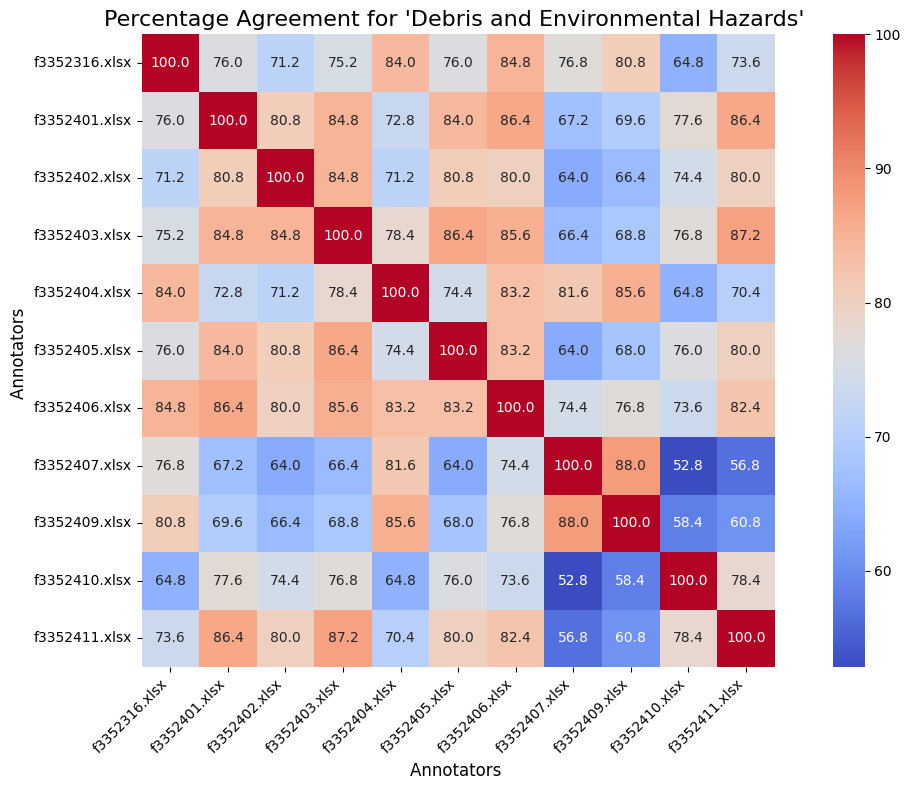

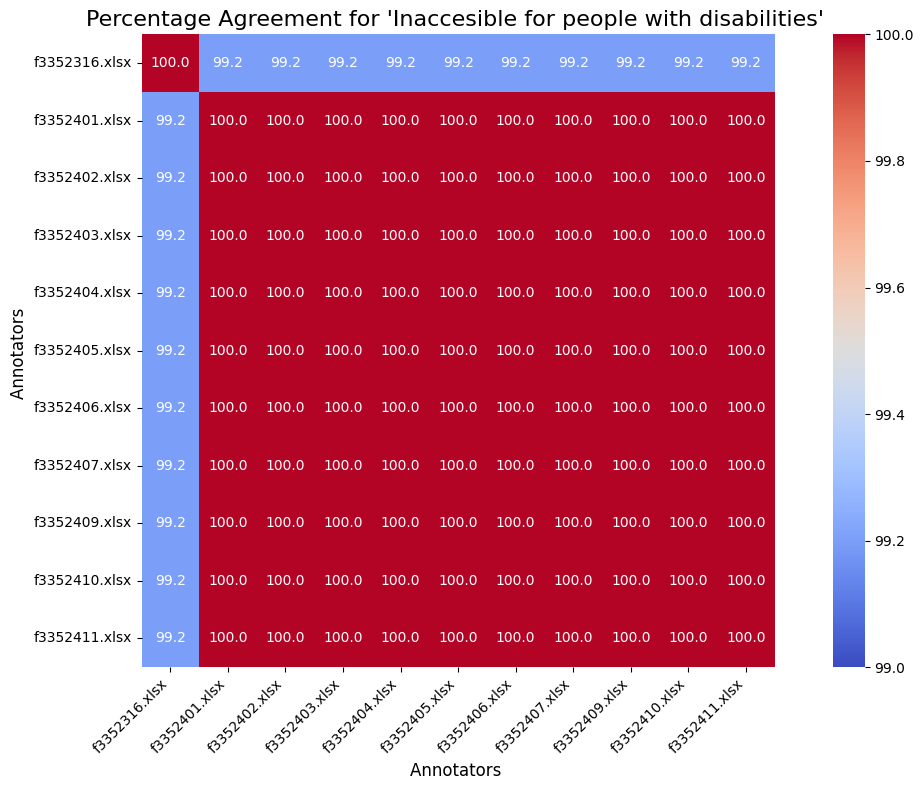

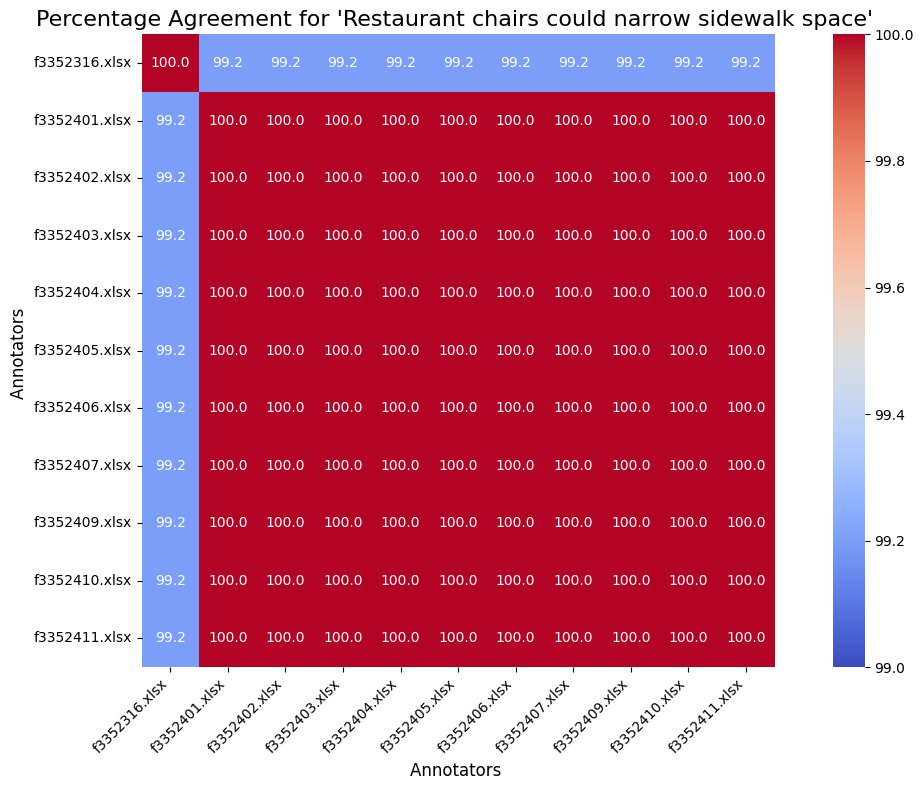

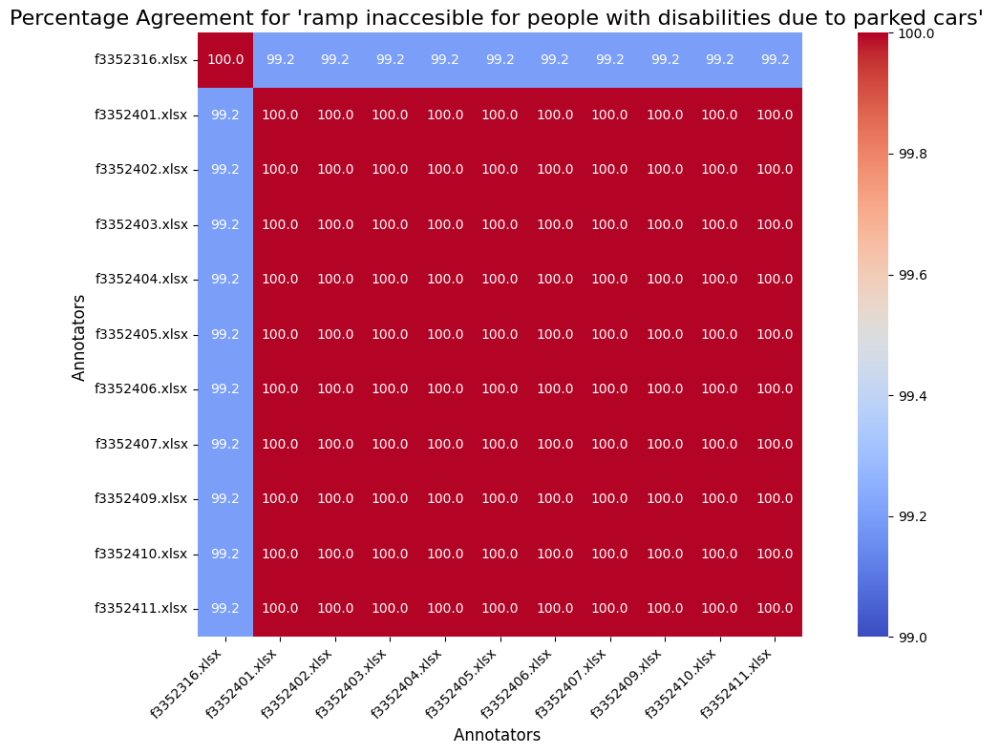

In [32]:
# Iterate through each category column
for category in category_columns:
    # Initialize a DataFrame to store the agreement for this category
    agreement_matrix = pd.DataFrame(np.zeros((len(dataframes), len(dataframes))),
                                    index=dataframes.keys(), columns=dataframes.keys())

    for file_name_1 in dataframes.keys():
        for file_name_2 in dataframes.keys():
            # Extract the category data for both files
            data_1 = dataframes[file_name_1][category]
            data_2 = dataframes[file_name_2][category]

            # Check if only one annotator has annotated this category
            if data_1.isna().all() or data_2.isna().all():  # If one of the annotators has not annotated this category
                agreement_percentage = 0
            else:
                # Calculate the number of matches (0 or 1)
                agreements = (data_1 == data_2).sum()  
                total_comparisons = len(data_1)  # Total number of annotations (assumed equal length)

                # Calculate the agreement percentage
                agreement_percentage = (agreements / total_comparisons) * 100 if total_comparisons > 0 else 0

            # If comparing the file to itself (diagonal), set agreement to 100%
            if file_name_1 == file_name_2:
                agreement_percentage = 100

            # Check if only one annotator annotated the category (to force non-diagonal agreement to 0%)
            annotator_count_1 = data_1.notna().sum()
            annotator_count_2 = data_2.notna().sum()

            if annotator_count_1 == 1 and annotator_count_2 == 1:
                if file_name_1 != file_name_2:
                    agreement_percentage = 0  # No agreement between different annotators if only one person annotated

            # Store the agreement percentage in the matrix
            agreement_matrix.loc[file_name_1, file_name_2] = agreement_percentage

    # Set a different colormap for the last three categories
    if category in ['Inaccesible for people with disabilities', 'Restaurant chairs could narrow sidewalk space', 'ramp inaccesible for people with disabilities due to parked cars']:
          cmap_value = "coolwarm"
          center_value = 99.5  # Set a smaller center value that highlights differences near 99.2 to 100
          vmin_value = 99  # Minimum value for zooming in on the range of interest
          vmax_value = 100  # Center value for the colormap
    else:
        cmap_value = "coolwarm"  # Default colormap for the other categories
        center_value = None  # No centering for the default colormap
        vmin_value = None  # No min/max for default
        vmax_value = None # Default colormap for the rest of the categories

    # Plot the heatmap for this category
    plt.figure(figsize=(12, 8))
    sns.heatmap(agreement_matrix, annot=True, fmt=".1f", cmap=cmap_value, center=center_value,
            vmin=vmin_value, vmax=vmax_value, cbar=True, square=True)
    plt.title(f"Percentage Agreement for '{category}' ", fontsize=16)
    plt.xlabel("Annotators ", fontsize=12)
    plt.ylabel("Annotators ", fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()


## Cohen's Kappa

$$ k = \frac{P_a - P_e}{1 - P_e} $$

Where:

- \(Pa\): The observed agreement (proportion of times the annotators agree).  
- \(Pe\): The expected agreement by chance (calculated based on the distribution of annotations).  


This code computes Cohen's Kappa values to measure the agreement between different annotators on categorical classifications for images. Cohen's Kappa is a statistical measure that evaluates the reliability of annotations by comparing the level of agreement between two raters. 

Cohen's Kappa range: from -1 to 1:
1. 1: Perfect agreement between annotators.
2. 0: No agreement beyond what would be expected by chance.
3. <0: Indicate less agreement than would be expected by chance.

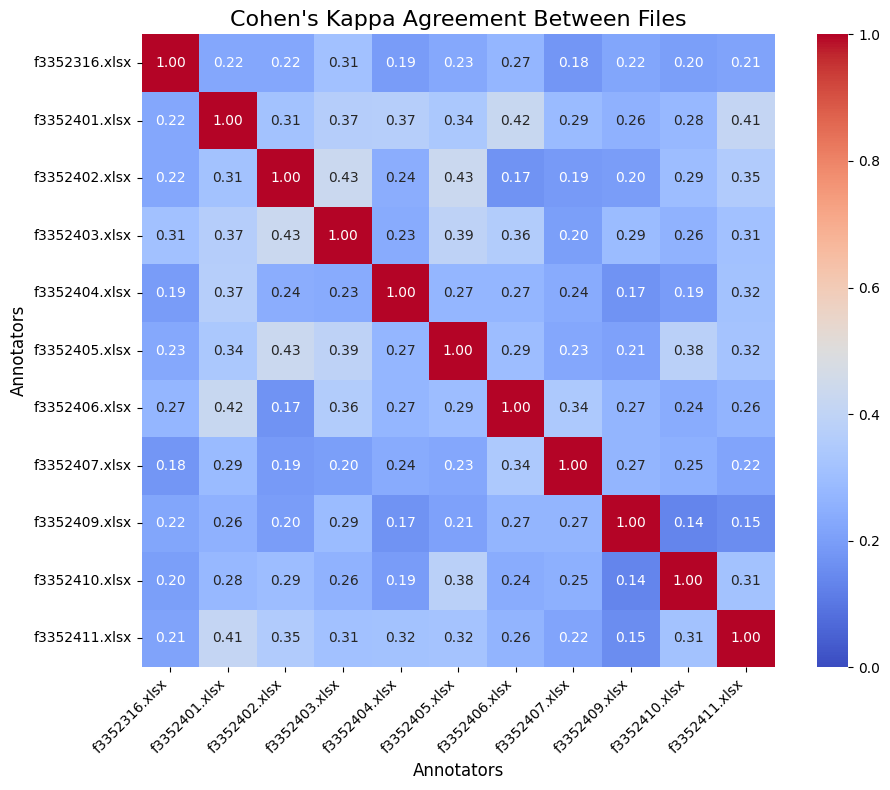

In [33]:
from sklearn.metrics import cohen_kappa_score
# Ensure there are at least two files to compare
if len(dataframes) < 2:
    print("Not enough files to calculate Cohen's Kappa.")
else:
    # Align all dataframes by their indices and columns
    aligned_data = pd.concat(dataframes.values(), axis=1, keys=dataframes.keys(), join='inner')

    # Initialize a DataFrame to store pairwise Cohen's Kappa
    file_names = list(dataframes.keys())
    kappa_matrix = pd.DataFrame(np.zeros((len(file_names), len(file_names))), 
                                index=file_names, columns=file_names)

    # Calculate pairwise Cohen's Kappa for all files
    for i, file_a in enumerate(file_names):
        for j, file_b in enumerate(file_names):
            if i < j:  # Avoid redundant calculations
                kappa_scores = []

                for category in category_columns:
                    # Extract the category data for the two files
                    if category in aligned_data[file_a].columns and category in aligned_data[file_b].columns:
                        data_a = aligned_data[file_a][category].fillna(0)
                        data_b = aligned_data[file_b][category].fillna(0)

                        # Compute Cohen's Kappa for the category
                        try:
                            kappa = cohen_kappa_score(data_a, data_b)
                            kappa_scores.append(kappa)
                        except ValueError:
                            kappa_scores.append(np.nan)  # Handle invalid cases

                # Average Cohen's Kappa across all categories
                if kappa_scores:
                    avg_kappa = np.nanmean(kappa_scores)
                    kappa_matrix.loc[file_a, file_b] = avg_kappa
                    kappa_matrix.loc[file_b, file_a] = avg_kappa

    # Fill the diagonal with 1.0 (perfect self-agreement for Cohen's Kappa)
    np.fill_diagonal(kappa_matrix.values, 1.0)

    # Display the heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(kappa_matrix, annot=True, fmt=".2f", cmap="coolwarm",center=None, vmin=0, vmax=1, cbar=True, square=True)
    plt.title("Cohen's Kappa Agreement Between Files", fontsize=16)
    plt.xlabel("Annotators", fontsize=12)
    plt.ylabel("Annotators", fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

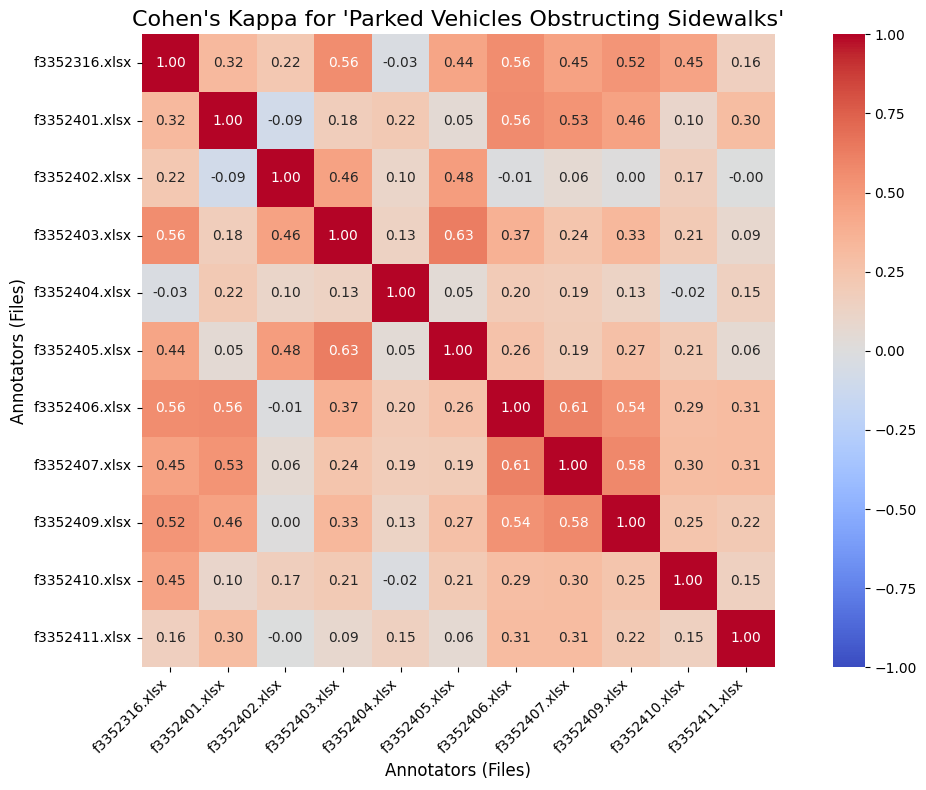

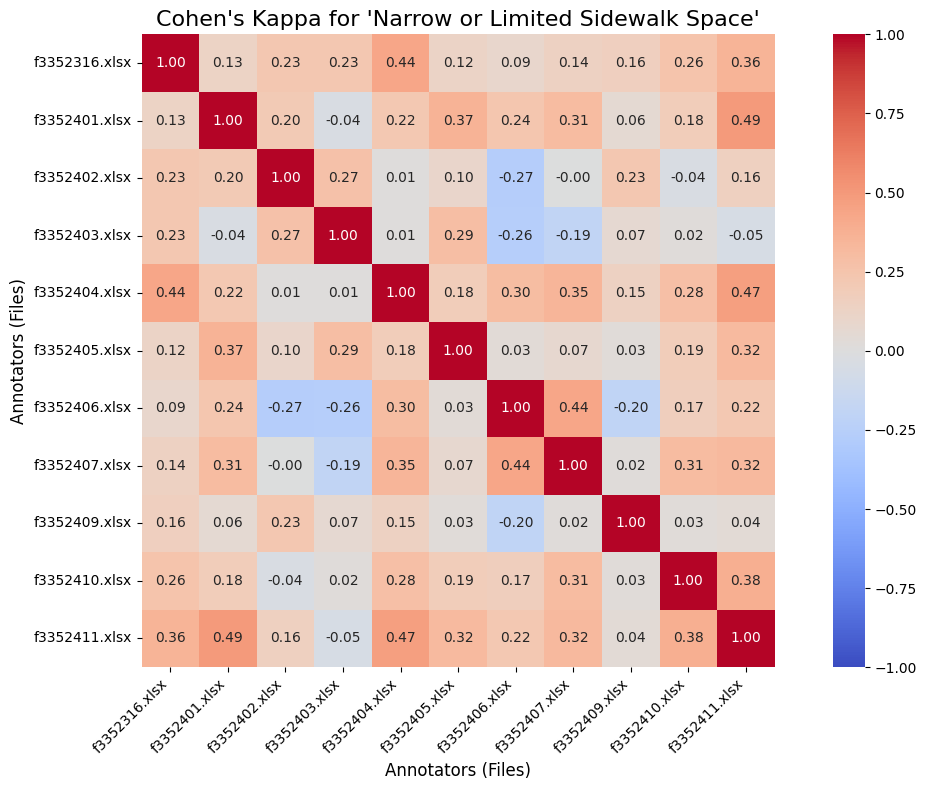

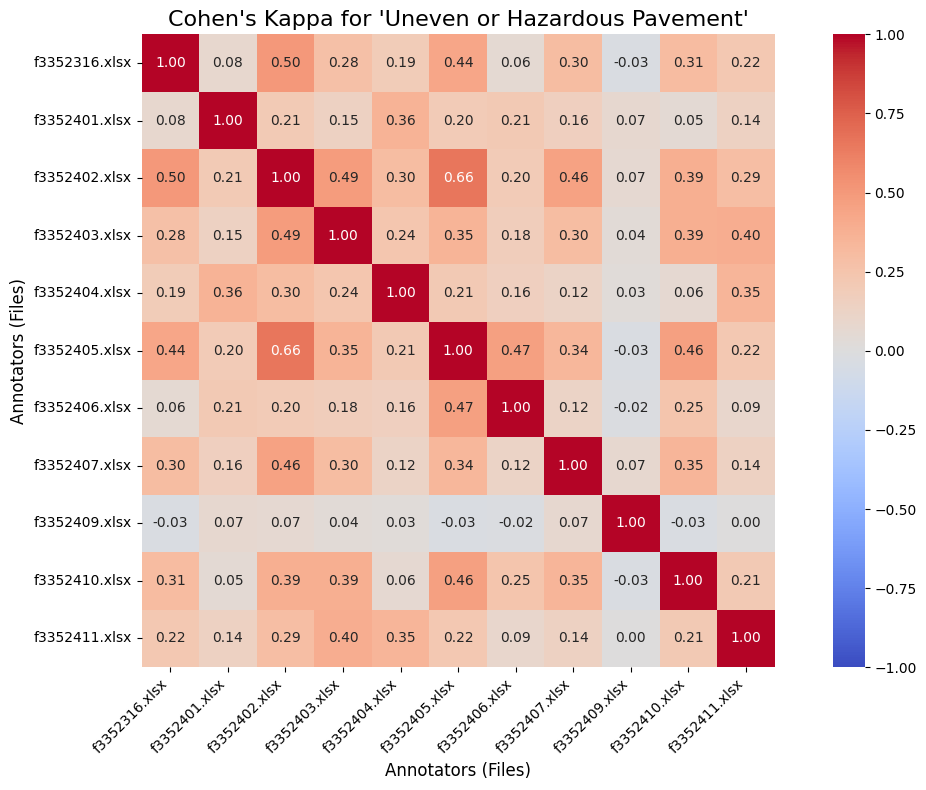

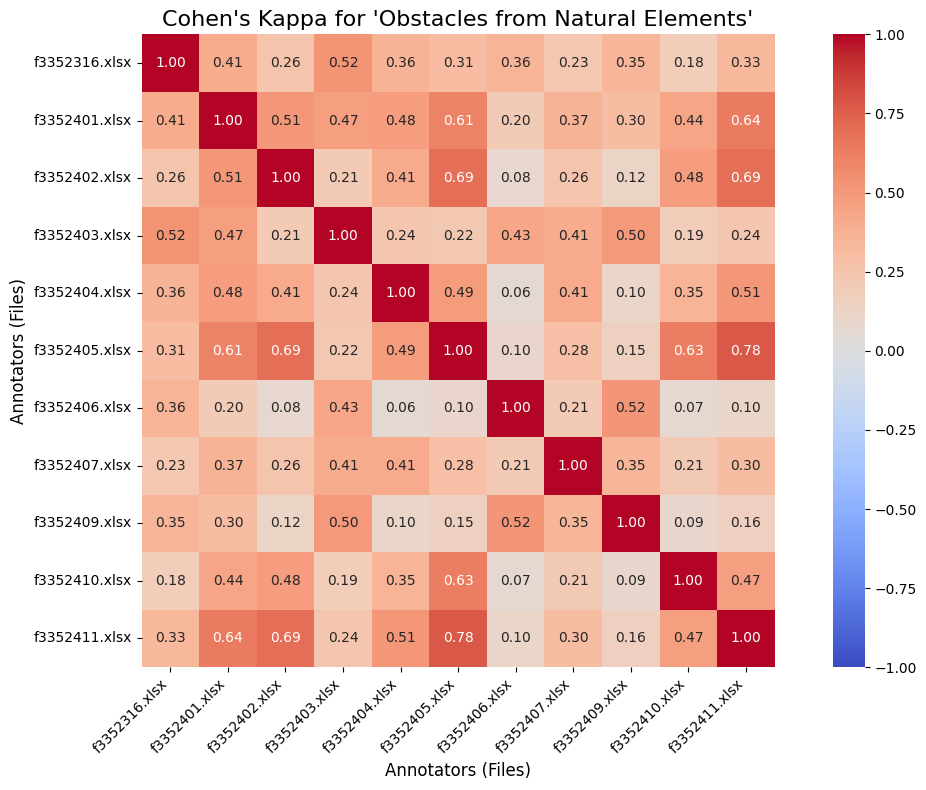

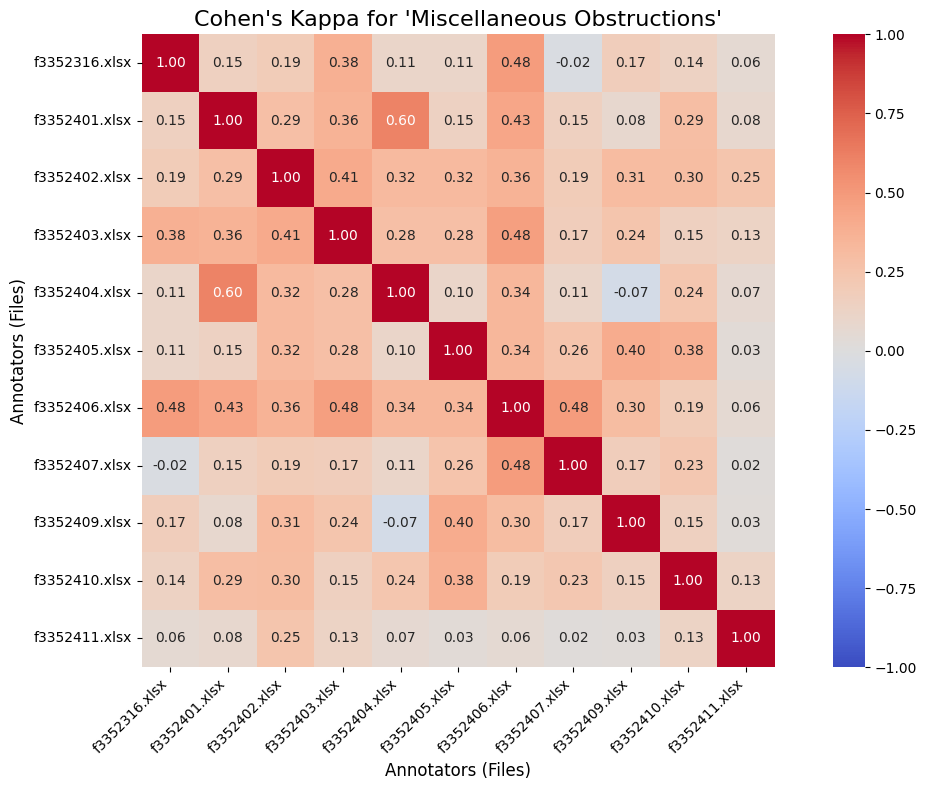

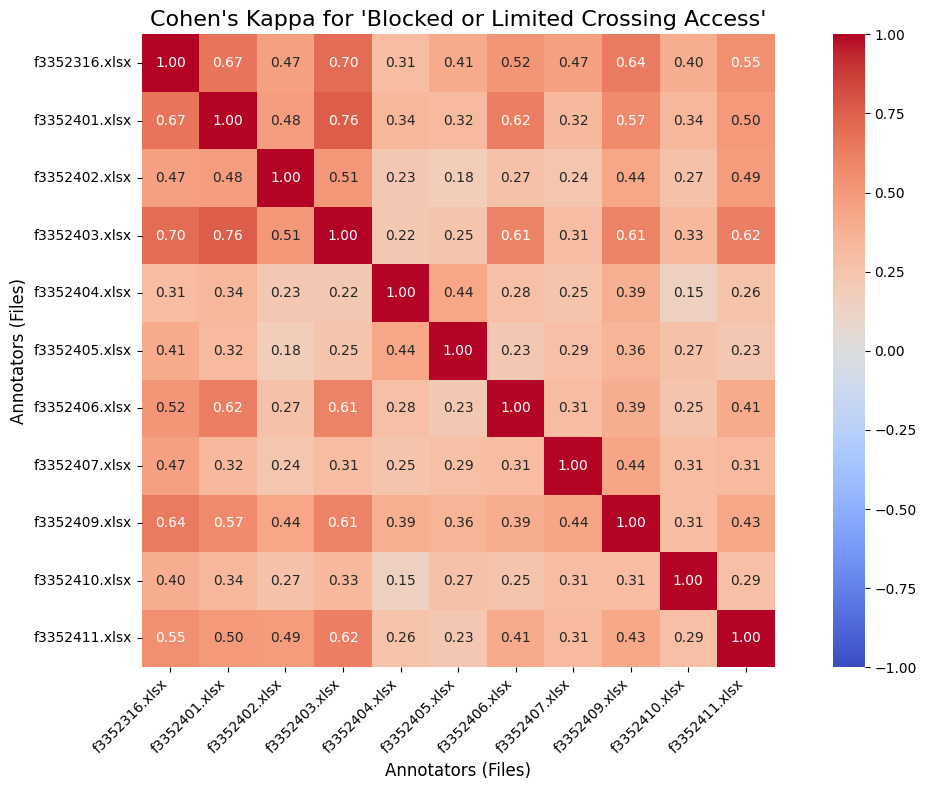

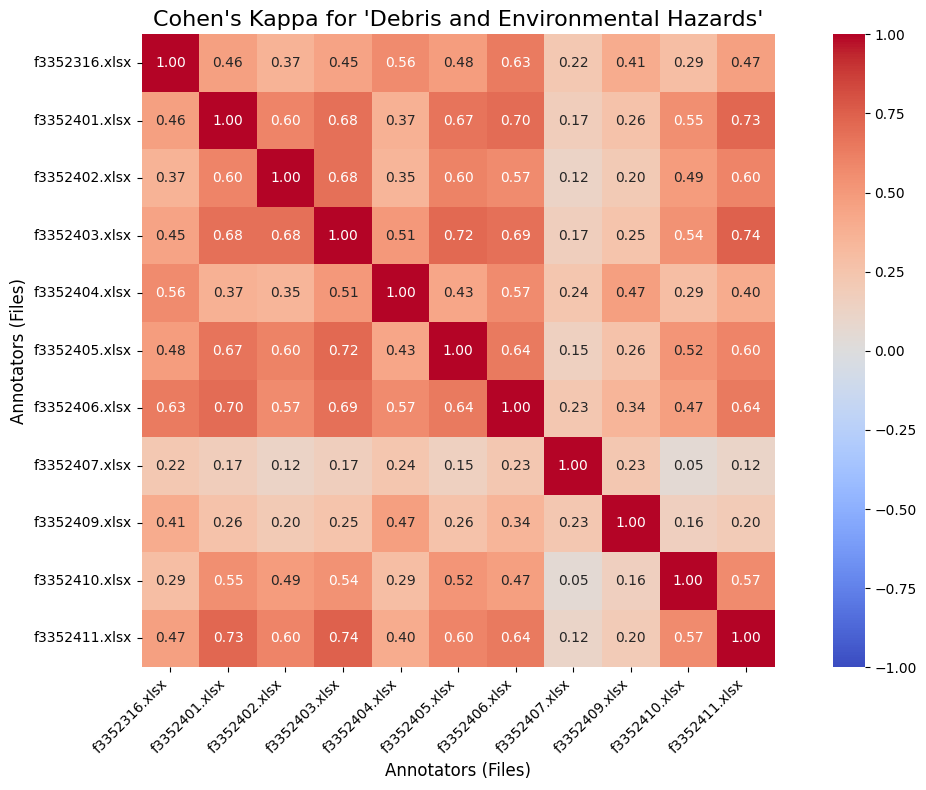

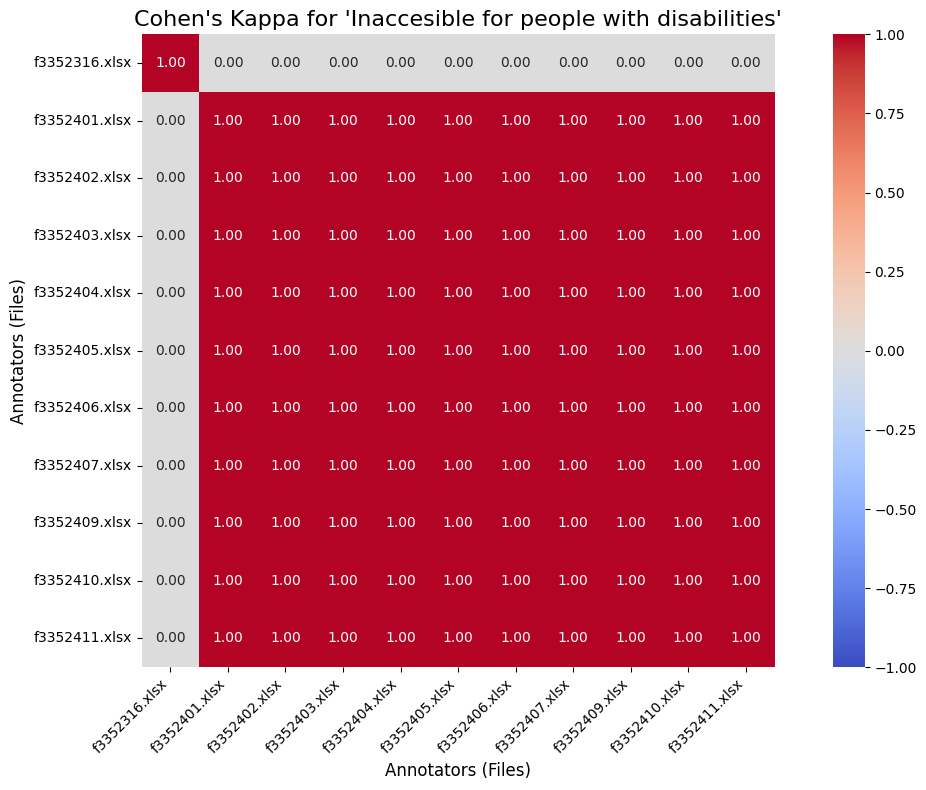

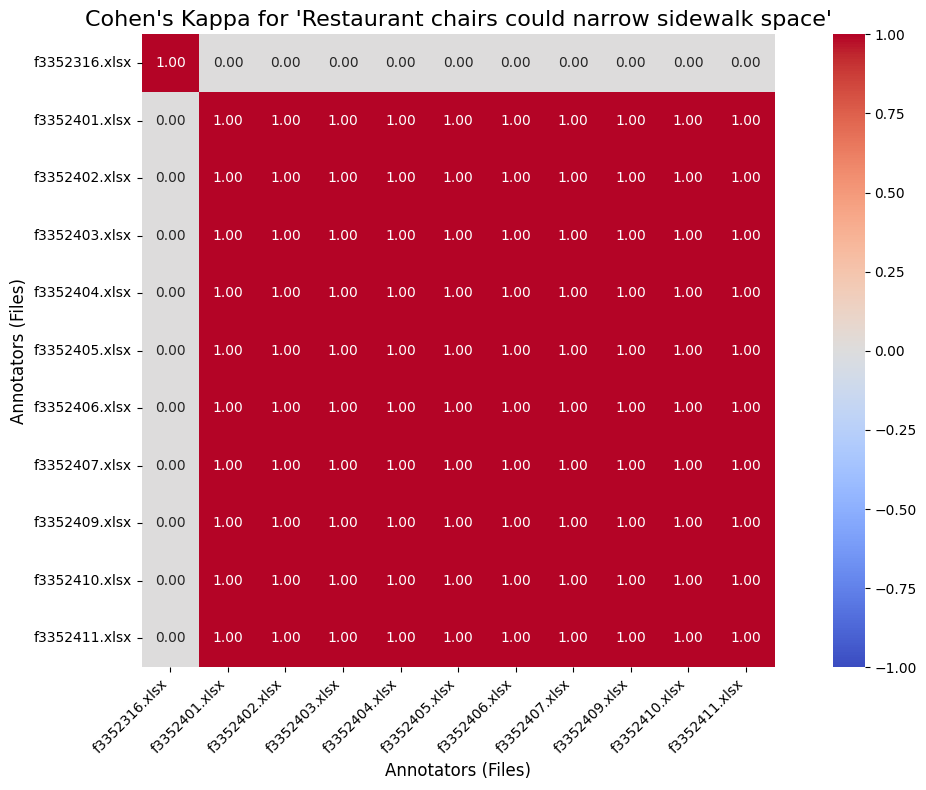

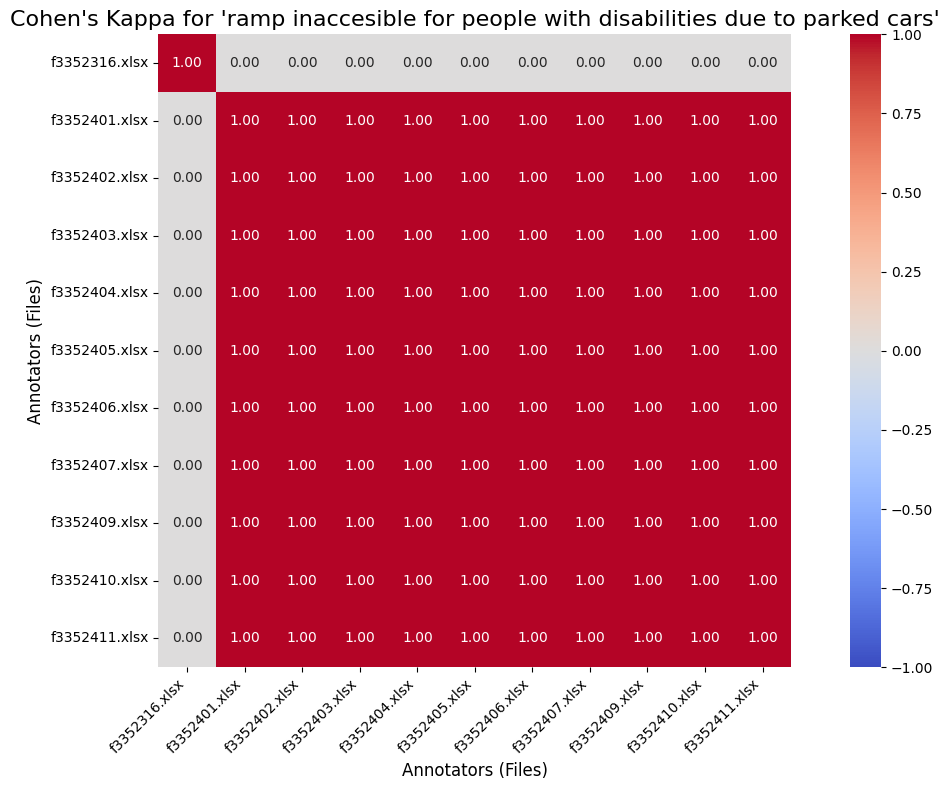

In [34]:
for category in category_columns:
    kappa_matrix = pd.DataFrame(np.zeros((len(dataframes), len(dataframes))),
                                index=dataframes.keys(), columns=dataframes.keys())

    for file_name_1 in dataframes.keys():
        for file_name_2 in dataframes.keys():
            data_1 = dataframes[file_name_1][category]
            data_2 = dataframes[file_name_2][category]

            # Replace NaN with 0 to ensure valid comparisons
            data_1 = data_1.fillna(0)
            data_2 = data_2.fillna(0)

            # Handle cases where all values are 0
            if (data_1 == 0).all() and (data_2 == 0).all():
                kappa_score = 1.0  # Perfect agreement on all zeros
            else:
                try:
                    kappa_score = cohen_kappa_score(data_1, data_2)
                except ValueError:
                    kappa_score = np.nan  # Handle cases where input is invalid

            # Ensure diagonal values are always 1
            if file_name_1 == file_name_2:
                kappa_score = 1.0

            # Store the Kappa score in the matrix
            kappa_matrix.loc[file_name_1, file_name_2] = kappa_score

    # Plot heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(kappa_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True, square=True,
                vmin=-1, vmax=1)  # Explicitly set range
    plt.title(f"Cohen's Kappa for '{category}'", fontsize=16)
    plt.xlabel("Annotators (Files)", fontsize=12)
    plt.ylabel("Annotators (Files)", fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()


In [53]:
root_path_athens = (r"C:/Users/maria/Desktop/athens")
images_path_athens = os.path.join(root_path_athens)

## Analysis for Athens: Cluster Membership and City Similarity

1. **Cluster Membership**:
   - Using representative images from Athens, we determine the clusters to which these images belong.
   - This provides insights into how Athens is distributed across the defined clusters.

2. **City Similarity**:
   - We compare Athens to other cities based on the cluster proportions.
   - Using similarity metrics, such as cosine similarity, we identify cities with similar distributions of features and cluster memberships to Athens.

In [54]:
# List the files in the directory and process them
image_data = []

def get_image_files_from_directory(directory):
    image_files = []
    # Common image file extensions to look for
    valid_extensions = ['.jpg', '.png']
    
    for root, dirs, files in os.walk(directory):  # Recursively go through subdirectories
        for file in files:
            # If the file has a valid image extension, add it to the list
            if any(file.lower().endswith(ext) for ext in valid_extensions):
                image_files.append(os.path.join(root, file))
    return image_files

# Get the image files from the 'Images' directory (including subdirectories)
image_files = get_image_files_from_directory(images_path_athens)

#print(f"Found {len(image_files)} image files: {image_files}") 

for image_path in image_files:
    try:
        #print(f"Processing image: {image_path}") 
        
        # Preprocess the image and extract features
        features = preprocess_image_cv2_correct(image_path)
        
        if features is not None:
            image_data.append({
                'city': 'athens',  # Add city name
                'image_name': os.path.basename(image_path),  # Use only the filename
                'features': features
            })
        else:
            print(f"Skipping image: {image_path}")
    except Exception as e:
        print(f"Error processing image {image_path}: {e}")

# Convert image_data into a format usable for clustering (array of features)
if image_data:
    images = np.array([item['features'] for item in image_data])
    images = np.array(images, dtype=np.float32)
    print(f"Original feature shape: {images.shape}")
else:
    print("No valid images processed.")

Original feature shape: (124, 1409)


In [58]:
# Apply PCA transformation to the new dataset
reduced_data_athens = pca.transform(images)

# Predict cluster labels for the new images
cluster_labels_athens = kmeans.predict(reduced_data_athens)

Cluster distribution for Athens images: Counter({0: 107, 5: 17})


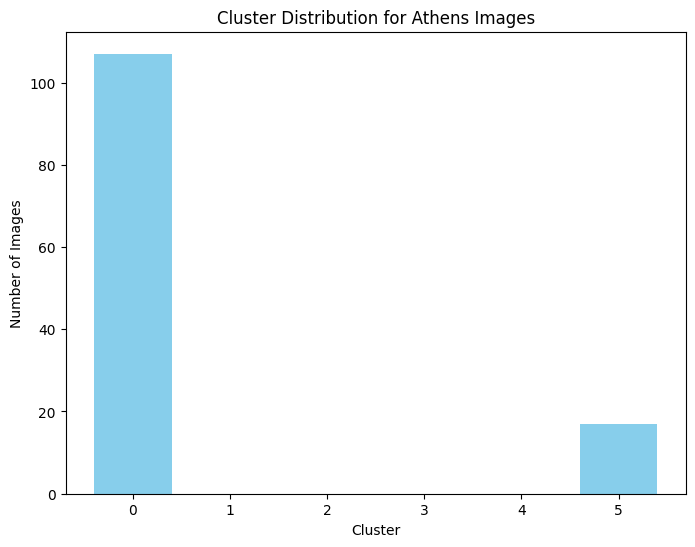

In [59]:
# Add the cluster labels to the image data for reference
for idx, item in enumerate(image_data):
    item['cluster'] = cluster_labels_athens[idx]

from collections import Counter
cluster_counts = Counter(cluster_labels_athens)
print("Cluster distribution for Athens images:", cluster_counts)


plt.figure(figsize=(8, 6))
plt.bar(cluster_counts.keys(), cluster_counts.values(), color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('Number of Images')
plt.title('Cluster Distribution for Athens Images')
plt.show()

In [60]:
for cluster_id in range(9):
    print(f"Cluster {cluster_id}: {sum(cluster_labels_athens == cluster_id)} members")

Cluster 0: 107 members
Cluster 1: 0 members
Cluster 2: 0 members
Cluster 3: 0 members
Cluster 4: 0 members
Cluster 5: 17 members
Cluster 6: 0 members
Cluster 7: 0 members
Cluster 8: 0 members


In [61]:
# Add Athens data to image_df
athens_df = pd.DataFrame(image_data)
image_df_total = pd.concat([image_df, athens_df], ignore_index=True)

# Calculate the cluster distribution for each city
city_cluster_counts = image_df_total.groupby(['city', 'cluster']).size().unstack(fill_value=0)

# Normalize the distributions
city_cluster_proportions = city_cluster_counts.div(city_cluster_counts.sum(axis=1), axis=0)

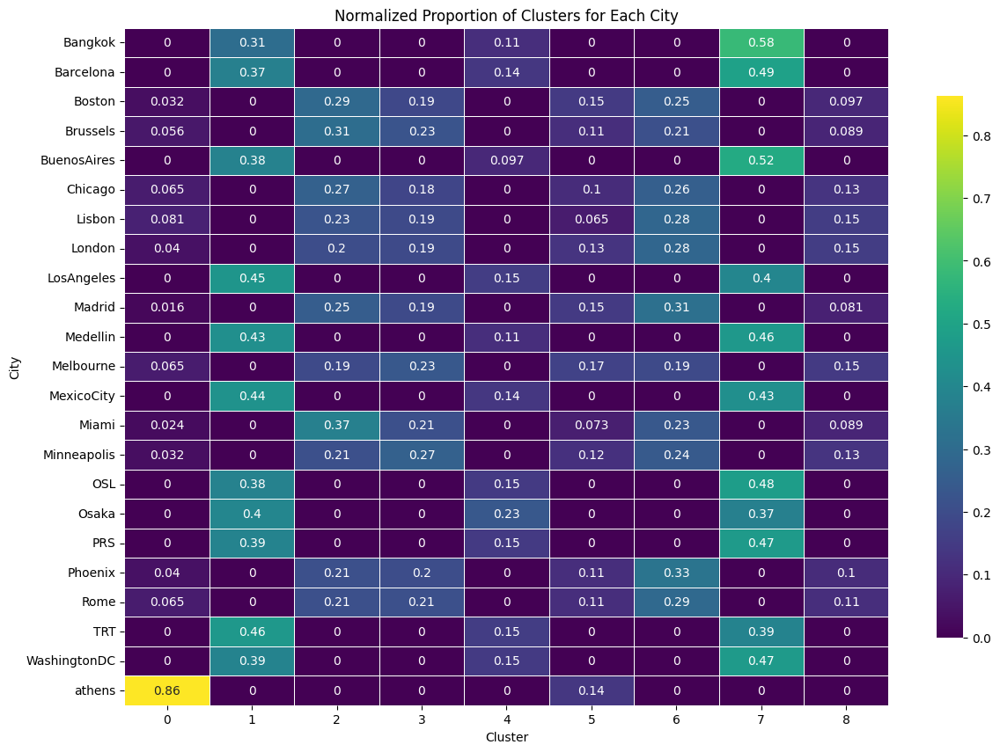

In [62]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot the normalized proportions of clusters for all cities using a heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(city_cluster_proportions, annot=True, cmap='viridis', linewidths=.5, cbar_kws={"shrink": .8})
plt.title('Normalized Proportion of Clusters for Each City')
plt.xlabel('Cluster')
plt.ylabel('City')
plt.show()

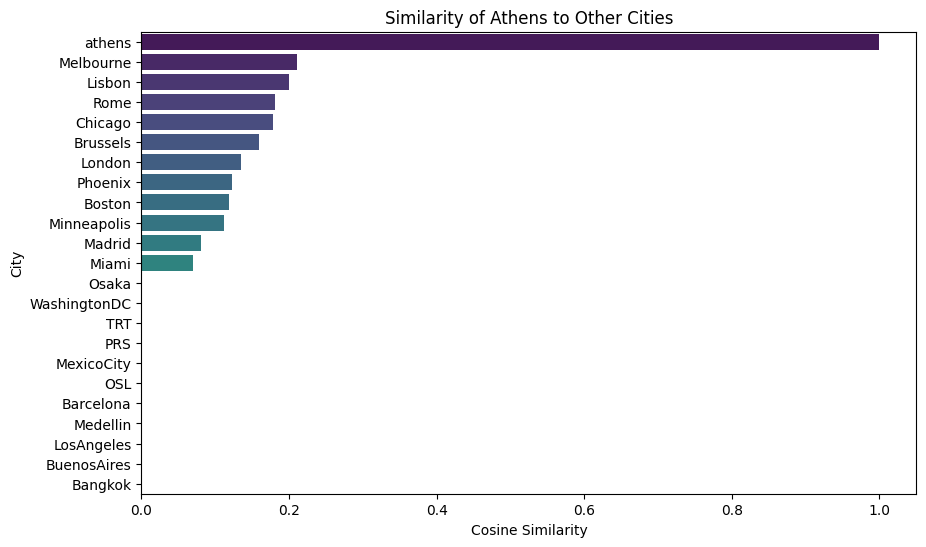

In [63]:
from sklearn.metrics.pairwise import cosine_similarity

# Get the proportions for Athens
athens_proportions = city_cluster_proportions.loc['athens'].values.reshape(1, -1)

# Calculate cosine similarity between Athens and other cities
similarity_scores = cosine_similarity(athens_proportions, city_cluster_proportions)[0]

# Create a DataFrame to display similarity scores
similarity_df = pd.DataFrame({'City': city_cluster_proportions.index, 'Similarity': similarity_scores})

# Sort by similarity
similarity_df = similarity_df.sort_values(by='Similarity', ascending=False)

# Visualize the similarity
plt.figure(figsize=(10, 6))
sns.barplot(x='Similarity', y='City', data=similarity_df, palette='viridis')
plt.title('Similarity of Athens to Other Cities')
plt.xlabel('Cosine Similarity')
plt.ylabel('City')
plt.show()


Displaying images from city: Miami


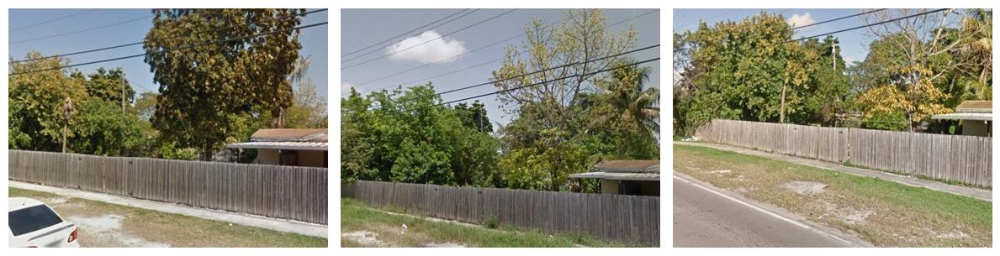

Displaying images from city: Madrid


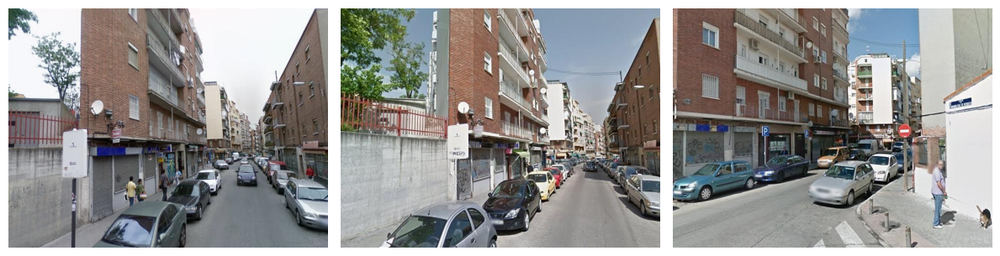

Displaying images from city: Minneapolis


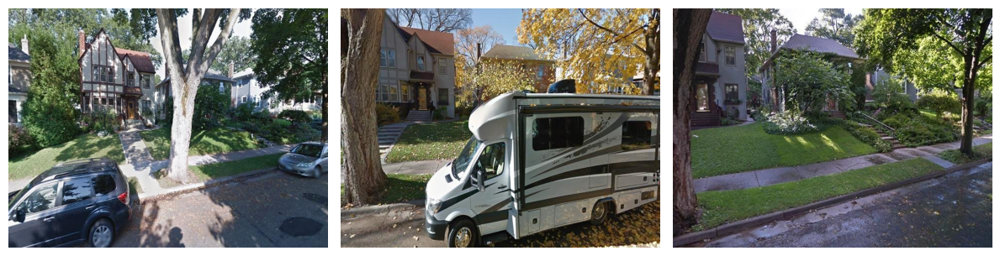

Displaying images from city: Boston


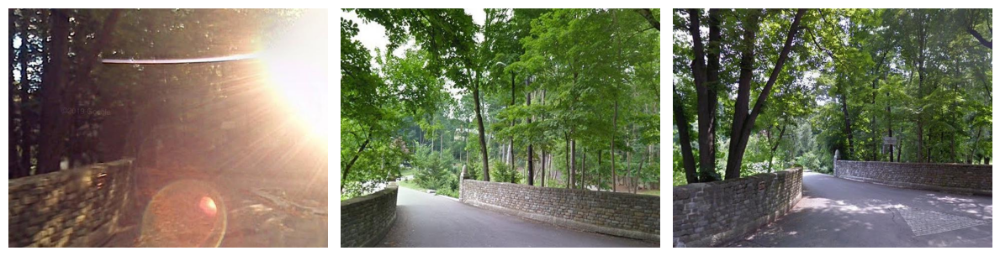

Displaying images from city: Phoenix


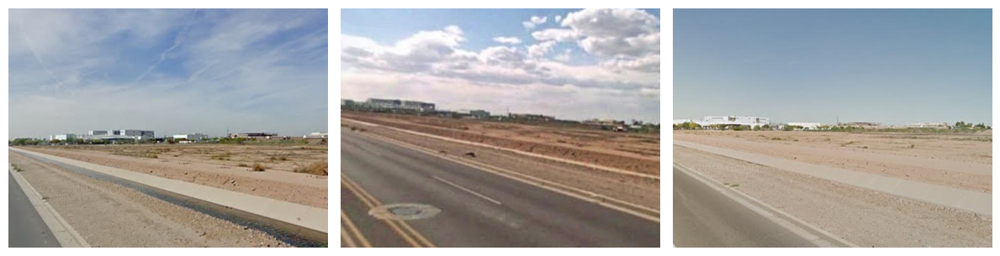

Displaying images from city: London


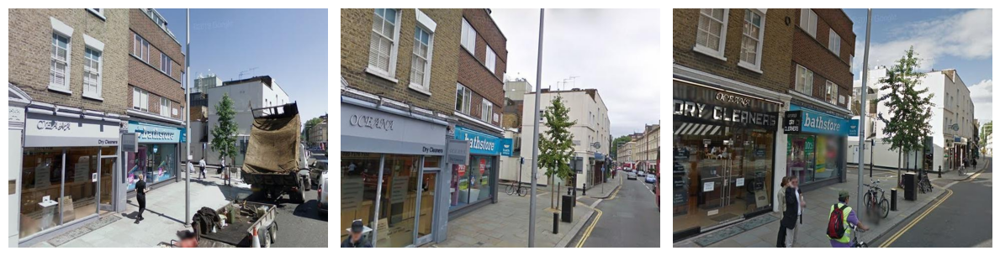

Displaying images from city: Brussels


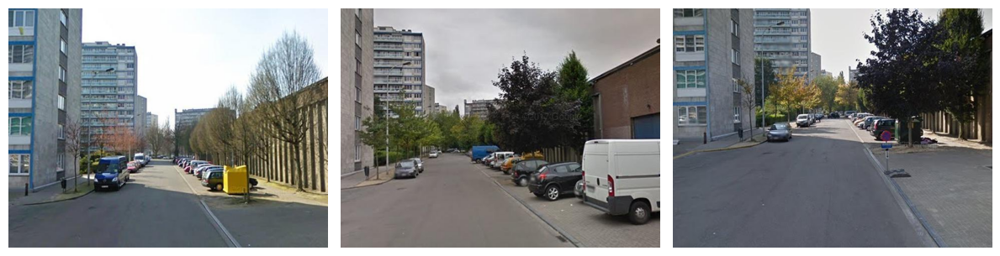

Displaying images from city: Chicago


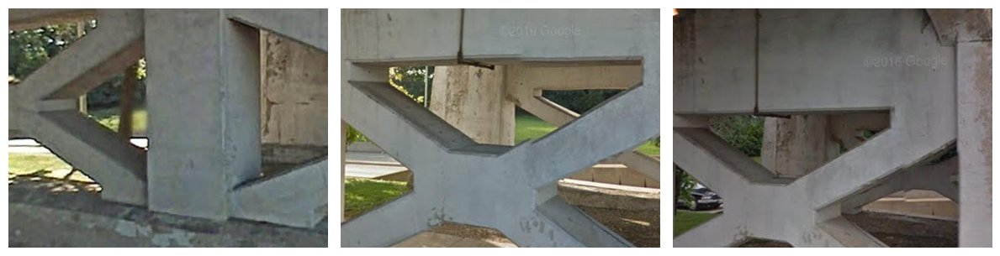

Displaying images from city: Rome


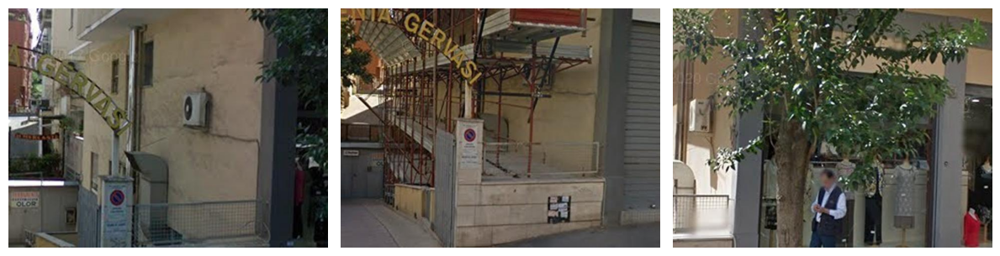

Displaying images from city: Lisbon


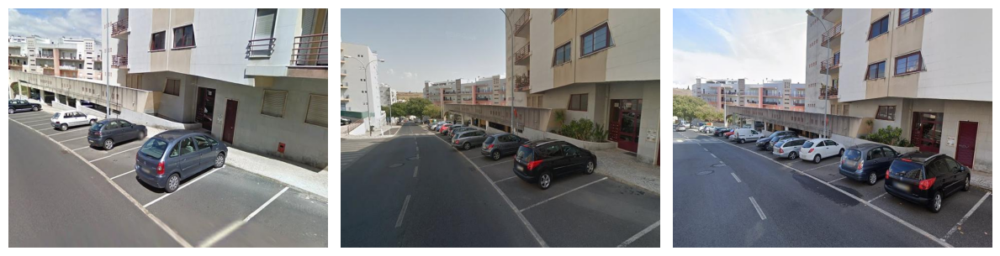

Displaying images from city: Melbourne


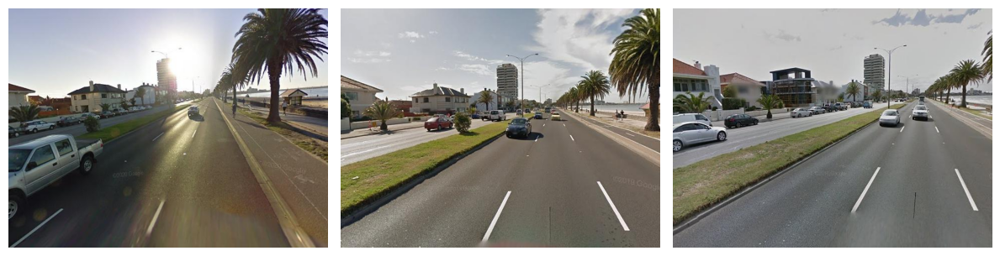

Displaying images for Athens...


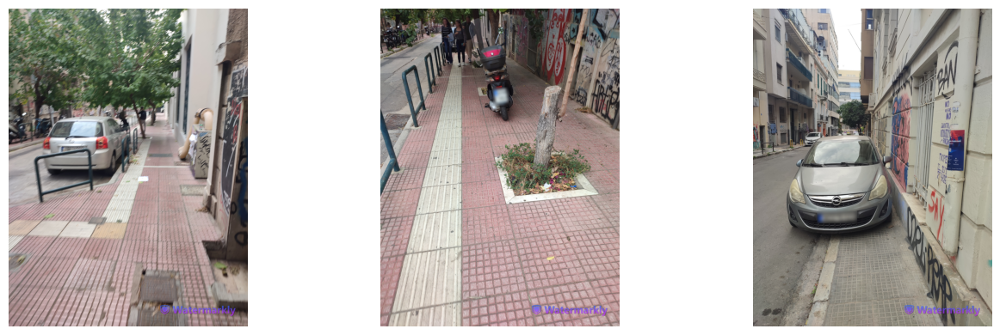

In [64]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# List of cities to display images from
selected_cities = ["Miami", "Madrid", "Minneapolis", "Boston", "Phoenix", 
                   "London", "Brussels", "Chicago", "Rome", "Lisbon", "Melbourne"]

# Set the number of images to display per city
images_per_city = 3
valid_extensions = ['.jpg', '.png']

for city in selected_cities:
    city_folder = os.path.join(images_path, city)  # Construct the folder path for each city
    if os.path.isdir(city_folder):
        print(f"Displaying images from city: {city}")
        
        # Get all image files in the city folder
        image_files = [
            os.path.join(city_folder, img) 
            for img in os.listdir(city_folder) 
            if any(img.lower().endswith(ext) for ext in valid_extensions)
        ]
        
        if image_files:
            # Select up to 3 images from the city folder
            selected_images = image_files[:images_per_city]
            
            # Plot the selected images
            plt.figure(figsize=(12, 4))
            for i, img_path in enumerate(selected_images):
                try:
                    img = Image.open(img_path)
                    plt.subplot(1, len(selected_images), i + 1)
                    plt.imshow(img)
                    plt.axis("off")
                except Exception as e:
                    print(f"Error opening image {img_path}: {e}")
            
            plt.tight_layout()
            plt.show()
        else:
            print(f"No valid images found in the folder: {city_folder}")
    else:
        print(f"Folder for city {city} does not exist.")

# List all image files in the Athens directory
image_files = [
    os.path.join(images_path_athens, img) 
    for img in os.listdir(images_path_athens) 
    if any(img.lower().endswith(ext) for ext in valid_extensions)
]

if image_files:
    print(f"Displaying images for Athens...")
    # Select up to 3 images from the Athens folder
    selected_images = image_files[:images_per_city]
    
    # Plot the selected images
    plt.figure(figsize=(14, 4))
    for i, img_path in enumerate(selected_images):
        try:
            img = Image.open(img_path)
            plt.subplot(1, len(selected_images), i + 1)
            plt.imshow(img)
            plt.axis("off")
        except Exception as e:
            print(f"Error opening image {img_path}: {e}")
    
    plt.tight_layout()
    plt.show()
else:
    print(f"No valid images found in the folder: {images_path_athens}")
